In [432]:
import neo
# general parameters
from vor_cerebellum.parameters import (CONNECTIVITY_MAP, rbls, neuron_params)
# MF-VN params
from vor_cerebellum.parameters import (mfvn_min_weight, mfvn_max_weight,
                                       mfvn_initial_weight,
                                       mfvn_ltp_constant,
                                       mfvn_beta, mfvn_sigma)
# PF-PC params
from vor_cerebellum.parameters import (pfpc_min_weight, pfpc_max_weight,
                                       pfpc_initial_weight,
                                       pfpc_ltp_constant, pfpc_t_peak)
from vor_cerebellum.utilities import *
import os
import elephant
import traceback
from pyNN.utility.plotting import Figure, Panel
from brian2.units import ms, Hz, second
from mpl_toolkits.axes_grid1 import make_axes_locatable, ImageGrid

In [519]:
# ensure we use viridis as the default cmap
plt.viridis()

# ensure we use the same rc parameters for all matplotlib outputs
mlib.rcParams.update({'font.size': 24})
mlib.rcParams.update({'errorbar.capsize': 5})
mlib.rcParams.update({'figure.autolayout': True})
viridis_cmap = mlib.cm.get_cmap('viridis')

<Figure size 432x288 with 0 Axes>

In [434]:
%matplotlib inline

In [657]:
path_to_results = "/localhome/mbax3pb2/anaconda3/envs/icub_vor_spinnaker/spinnaker/vor_cerebellum/vor_cerebellum/full_scale_tests/results/"


# suffix= "_100s_gain_40"
# file = "full_cerebellum_test_100s_gain_40.npz"

# suffix= "_100s_gain_40_liniar"
# file = "full_cerebellum_test_100s_gain_40_slowdown_5_liniar.npz"

suffix = ""
# file = "50000_gain_40_slowdown_1_POSITION_lin_pcvn_2.npz"

file = "100000_gain_40_slowdown_1_0.01_sweep_pcvn_50_50.npz"

path_to_results = "/localhome/mbax3pb2/anaconda3/envs/icub_vor_spinnaker/spinnaker/vor_cerebellum/vor_cerebellum/full_scale_tests/target_reaching_experiments/results"
# file = "100000_gain_20_slowdown_10_0_target_reaching_VELOCITY_DRIVEN_MORE_LTD_slow.npz"
file = "200000_gain_100_slowdown_10_0_target_reaching_NO_NORM_x.npz"

filename = os.path.join(path_to_results, file)

data = np.load(filename, allow_pickle=True)
print(data.files)

['simulation_parameters', 'all_spikes', 'neo_all_spikes', 'other_recordings', 'all_neurons', 'all_neuron_params', 'final_connectivity', 'initial_connectivity', 'simtime', 'conn_params', 'cell_params', 'per_pop_neurons_per_core_constraint', 'icub_snapshots']


In [658]:
all_spikes = data['all_spikes'].ravel()[0]
all_neurons = data['all_neurons'].ravel()[0]
simulation_parameters = data['simulation_parameters'].ravel()[0]
other_recordings = data['other_recordings'].ravel()[0]
final_connectivity = data['final_connectivity'].ravel()[0]
simtime = data['simtime']
cell_params = data['cell_params'].ravel()[0]
per_pop_neurons_per_core_constraint = data['per_pop_neurons_per_core_constraint'].ravel()[0]
icub_snapshots = data['icub_snapshots']


In [659]:
args = simulation_parameters['argparser'] 

In [660]:
# neo_all_recordings = data['neo_all_recordings'].ravel()[0]
neo_all_spikes = data['neo_all_spikes'].ravel()[0]

In [661]:
# Pre-compute conversions
time_to_bin_conversion = 1.0 / (1.0)
bins_in_3ms = int(3 * time_to_bin_conversion)
no_timesteps = int(simtime / ms * time_to_bin_conversion)
pad_to_compute_3ms_bins = bins_in_3ms - no_timesteps % bins_in_3ms

In [662]:
# Compute plot order
plot_order = get_plot_order(all_spikes.keys())
n_plots = float(len(plot_order))

Plot order: ['mossy_fibres', 'granule', 'golgi', 'purkinje', 'climbing_fibres', 'vn']


In [663]:
simulation_parameters.keys()

dict_keys(['rbls', 'argparser', 'run_end_time', 'git_hash', 'n_neurons_per_core', 'runtime', 'cf_size', 'wall_clock_script_run_time', 'wall_clock_sim_run_time', 'error_window_size', 'gain', 'perfect_eye_vel', 'cf_spikes', 'vn_size', 'vn_spikes', 'ss_neurons_per_core', 'perfect_eye_pos'])

Analysis report
--------------------------------------------------------------------------------
Current time 16:01:41 on 08.02.2021
Number of neurons in each population
--------------------------------------------------------------------------------
	mossy_fibres         ->        100 neurons
	granule              ->       2000 neurons
	golgi                ->        100 neurons
	purkinje             ->        200 neurons
	climbing_fibres      ->        200 neurons
	vn                   ->        200 neurons
Average weight per projection
--------------------------------------------------------------------------------
mf_grc                      -> 0.500742 uS
pf_pc                       -> 0.000620 uS
mf_goc                      -> 0.079987 uS
pc_vn                       -> 0.004999 uS
goc_grc_1                   -> 0.001953 uS
pc_vn_teaching              -> 0.000000 uS
goc_grc_2                   -> 0.001953 uS
mf_vn                       -> 0.000551 uS
cf_pc                       ->

Traceback (most recent call last):
  File "<ipython-input-664-92c2aaf4719e>", line 50, in <module>
    mean = np.mean(conn[:, 3])
IndexError: too many indices for array
Traceback (most recent call last):
  File "<ipython-input-664-92c2aaf4719e>", line 50, in <module>
    mean = np.mean(conn[:, 3])
IndexError: too many indices for array
Traceback (most recent call last):
  File "<ipython-input-664-92c2aaf4719e>", line 50, in <module>
    mean = np.mean(conn[:, 3])
IndexError: too many indices for array
Traceback (most recent call last):
  File "<ipython-input-664-92c2aaf4719e>", line 50, in <module>
    mean = np.mean(conn[:, 3])
IndexError: too many indices for array
Traceback (most recent call last):
  File "<ipython-input-664-92c2aaf4719e>", line 50, in <module>
    mean = np.mean(conn[:, 3])
IndexError: too many indices for array
Traceback (most recent call last):
  File "<ipython-input-664-92c2aaf4719e>", line 50, in <module>
    mean = np.mean(conn[:, 3])
IndexError: too many indi

Plotting                                :figures/raster_plots.png               
Plotting                                :figures/raster_plots.pdf               


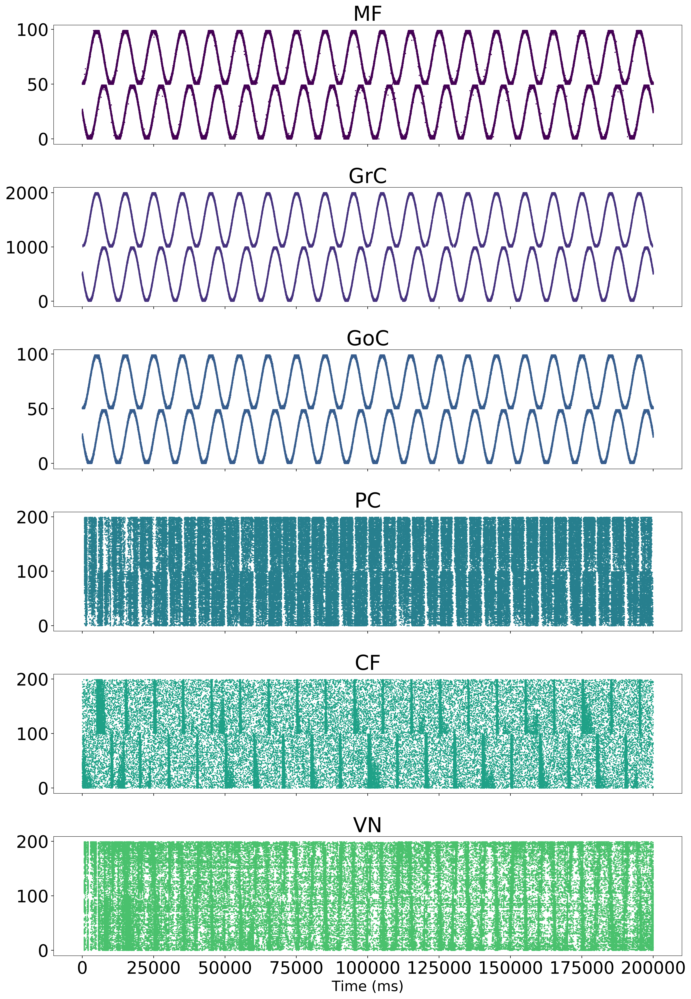

In [664]:
# Report useful parameters
print("=" * 80)
print("Analysis report")
print("-" * 80)
print("Current time",
      plt.datetime.datetime.now().strftime("%H:%M:%S on %d.%m.%Y"))
# Report number of neurons
print("=" * 80)
print("Number of neurons in each population")
print("-" * 80)
for pop in plot_order:
    print("\t{:20} -> {:10} neurons".format(pop, all_neurons[pop]))

# Report weights values
print("Average weight per projection")
print("-" * 80)
conn_dict = {}
for key in final_connectivity:
    # Connection holder annoyance here:
    conn = np.asarray(final_connectivity[key][-1])
    if final_connectivity[key] is None or conn.size == 0:
        print("Skipping analysing connection", key)
        continue
    conn_exists = True
    if len(conn.shape) == 1 or conn.shape[1] != 4:
        try:
            x = np.concatenate(conn)
            conn = x
        except:
            traceback.print_exc()
        names = [('source', 'int_'),
                 ('target', 'int_'),
                 ('weight', 'float_'),
                 ('delay', 'float_')]
        useful_conn = np.zeros((conn.shape[0], 4), dtype=np.float)
        for i, (n, _) in enumerate(names):
            useful_conn[:, i] = conn[n].astype(np.float)
        final_connectivity[key] = useful_conn.astype(np.float)
        conn = useful_conn.astype(np.float)
    conn_dict[key] = conn
    mean = np.mean(conn[:, 2])
    print("{:27} -> {:4.6f} uS".format(
        key, mean))

print("Average Delay per projection")
print("-" * 80)
for key in final_connectivity:
    try:
        conn = conn_dict[key][-1]
        mean = np.mean(conn[:, 3])
        print("{:27} -> {:4.2f} ms".format(
            key, mean))
    except:
        print(key)
        traceback.print_exc()


print("Plotting spiking raster plot for all populations")
f, axes = plt.subplots(len(all_spikes.keys()), 1,
                       figsize=(14, 20), sharex=True, dpi=400)
for index, pop in enumerate(plot_order):
    curr_ax = axes[index]
    # spike raster
    if pop == "vn":
        _times = simulation_parameters['vn_spikes'][:, 1]
        _ids = simulation_parameters['vn_spikes'][:, 0]
    else:
        _times = all_spikes[pop][:, 1]
        _ids = all_spikes[pop][:, 0]

    curr_ax.scatter(_times,
                    _ids,
                    color=viridis_cmap(index / (n_plots + 1)),
                    s=.5, rasterized=True)
    curr_ax.set_title(use_display_name(pop))
plt.xlabel("Time (ms)")
f.tight_layout()
save_figure(plt, os.path.join(fig_folder, "raster_plots" + suffix),
            extensions=['.png', '.pdf'])
plt.show()
plt.close(f)




In [665]:
for proj, conn in final_connectivity.items():
    if proj in ['mf_vn', 'pf_pc']:
        no_cons = len(conn)
    else:
        no_cons = 1
    for i in range(no_cons):
        f = plt.figure(1, figsize=(9, 9), dpi=400)
        plt.hist(conn[i][:, 2], bins=20)
        plt.title(use_display_name(proj))
        plt.xlabel("Weight")
        plt.ylabel("Count")
        save_figure(plt, os.path.join(fig_folder, "{}_weight_histogram_snap{}".format(proj, i) + suffix),
                    extensions=['.png', ])
        plt.close(f)

Plotting                                :figures/mf_grc_weight_histogram_snap0.png
Plotting                                :figures/pf_pc_weight_histogram_snap0.png
Plotting                                :figures/pf_pc_weight_histogram_snap1.png
Plotting                                :figures/pf_pc_weight_histogram_snap2.png
Plotting                                :figures/pf_pc_weight_histogram_snap3.png
Plotting                                :figures/pf_pc_weight_histogram_snap4.png
Plotting                                :figures/pf_pc_weight_histogram_snap5.png
Plotting                                :figures/pf_pc_weight_histogram_snap6.png
Plotting                                :figures/pf_pc_weight_histogram_snap7.png
Plotting                                :figures/pf_pc_weight_histogram_snap8.png
Plotting                                :figures/pf_pc_weight_histogram_snap9.png
Plotting                                :figures/pf_pc_weight_histogram_snap10.png
Plotting      

In [666]:
def plot_results(results_dict, simulation_parameters, name, all_spikes, xlim=None):
    # unpacking results
    errors = results_dict['errors']
    l_counts = results_dict['l_counts']
    r_counts = results_dict['r_counts']
    rec_eye_pos = results_dict['rec_eye_pos']
    rec_eye_vel = results_dict['rec_eye_vel']

    # unpacking simulation params
    runtime = simulation_parameters['runtime']
    error_window_size = simulation_parameters['error_window_size']
    vn_spikes = simulation_parameters['vn_spikes']
    cf_spikes = simulation_parameters['cf_spikes']
    pc_spikes = all_spikes['purkinje']
    perfect_eye_pos = simulation_parameters['perfect_eye_pos']
    perfect_eye_vel = simulation_parameters['perfect_eye_vel']
    vn_size = simulation_parameters['vn_size']
    cf_size = simulation_parameters['cf_size']

    # plot the data from the ICubVorEnv pop
    x_plot = np.array([(n) for n in range(0, runtime, error_window_size)])
    fig = plt.figure(figsize=(15, 20), dpi=400)
    # Spike raster plot
    ax = plt.subplot(6, 1, 1)
    highlight_area(ax, runtime, vn_size // 2, vn_size)
    first_half_filter = vn_spikes[:, 0] < vn_size // 2
    second_half_filter = ~first_half_filter
    plt.scatter(
        vn_spikes[second_half_filter, 1], vn_spikes[second_half_filter, 0],
        s=1, color=viridis_cmap(.75), rasterized=True)
    plt.scatter(
        vn_spikes[first_half_filter, 1], vn_spikes[first_half_filter, 0],
        s=1, color=viridis_cmap(.25), rasterized=True)
    ax.set_ylabel("VN")
    if xlim:
        plt.xlim(xlim)
    else:
        plt.xlim([0, runtime])
    plt.ylim([-0.1, vn_size + 0.1])
    # L/R counts
    ax2 = plt.subplot(6, 1, 2)
    plt.plot(x_plot, l_counts, 'o', color=viridis_cmap(.25), label="l_counts", rasterized=True)
    plt.plot(x_plot, r_counts, 'o', color=viridis_cmap(.75), label="r_counts", rasterized=True)
    plt.legend(loc="best")
    ax2.set_ylabel("R/L accums.")
    if xlim:
        plt.xlim(xlim)
    else:
        plt.xlim([0, runtime])
    # Positions and velocities

    len_recs = len(rec_eye_pos.ravel())
    # Pos and vel
    ax2 = plt.subplot(6, 1, 3)
    plt.plot(x_plot, rec_eye_pos, label="rec. eye position")
    plt.plot(x_plot, rec_eye_vel, label="rec. eye velocity")
    plt.plot(x_plot, np.tile(perfect_eye_pos[::error_window_size], runtime // 1000)[:len_recs],
             label="eye position", ls=':', rasterized=True)
    plt.plot(x_plot, np.tile(perfect_eye_vel[::error_window_size], runtime // 1000)[:len_recs],
             label="eye velocity", ls=':', rasterized=True)
    plt.legend(loc="best")
    ax2.set_ylabel("Pos. & Vel.")
    if xlim:
        plt.xlim(xlim)
    else:
        plt.xlim([0, runtime])
    # Errors
    ax2 = plt.subplot(6, 1, 4)
    plt.plot(x_plot, errors, label="recorded error")
    eye_pos_diff = np.tile(perfect_eye_pos[::error_window_size], runtime // 1000)[:len_recs] - rec_eye_pos.ravel()
    eye_vel_diff = np.tile(perfect_eye_vel[::error_window_size], runtime // 1000)[:len_recs] - rec_eye_vel.ravel()
    reconstructed_error = eye_pos_diff + eye_vel_diff

    #     plt.plot(x_plot, reconstructed_error, color='k', ls=":", label="reconstructed error")
    plt.plot(x_plot, eye_pos_diff,
             label="eye position diff", rasterized=True)
    plt.plot(x_plot, eye_vel_diff,
             label="eye velocity diff", rasterized=True)
    plt.legend(loc="best")
    ax2.set_ylabel("Error")
    if xlim:
        plt.xlim(xlim)
    else:
        plt.xlim([0, runtime])
    # Error spikes
    ax2 = plt.subplot(6, 1, 5)
    highlight_area(ax2, runtime, cf_size // 2, cf_size)
    first_half_filter = cf_spikes[:, 0] < cf_size // 2
    second_half_filter = ~first_half_filter
    plt.scatter(
        cf_spikes[second_half_filter, 1], cf_spikes[second_half_filter, 0],
        s=1, color=viridis_cmap(.75), rasterized=True)
    plt.scatter(
        cf_spikes[first_half_filter, 1], cf_spikes[first_half_filter, 0],
        s=1, color=viridis_cmap(.25), rasterized=True)
    ax2.set_ylabel("CF")

    # PC spikes
    ax2 = plt.subplot(6, 1, 6)
    highlight_area(ax2, runtime, cf_size // 2, cf_size)
    first_half_filter = pc_spikes[:, 0] < cf_size // 2
    second_half_filter = ~first_half_filter
    ax2.scatter(
        pc_spikes[second_half_filter, 1], pc_spikes[second_half_filter, 0],
        s=1, color=viridis_cmap(.75), rasterized=True)
    ax2.scatter(
        pc_spikes[first_half_filter, 1], pc_spikes[first_half_filter, 0],
        s=1, color=viridis_cmap(.25), rasterized=True)
    ax2.set_ylabel("PC")

    if xlim:
        plt.xlim(xlim)
    else:
        plt.xlim([0, runtime])
    plt.ylim([-0.1, cf_size + 0.1])
    plt.xlabel("Time (ms)")
    save_figure(plt, name, extensions=[".png", ".pdf", ])
    plt.show()
    plt.close(fig)

Plotting                                :figures/cerebellum_icub_snap_0_first_diff.png
Plotting                                :figures/cerebellum_icub_snap_0_first_diff.pdf


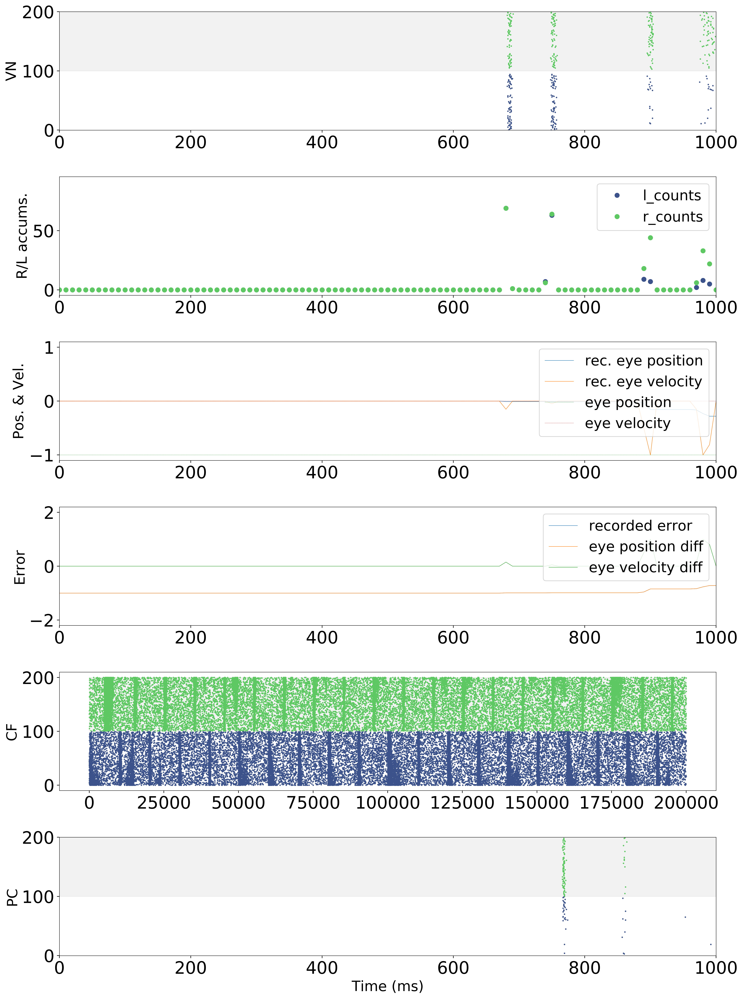

Plotting                                :figures/cerebellum_icub_snap_0_last_diff.png
Plotting                                :figures/cerebellum_icub_snap_0_last_diff.pdf


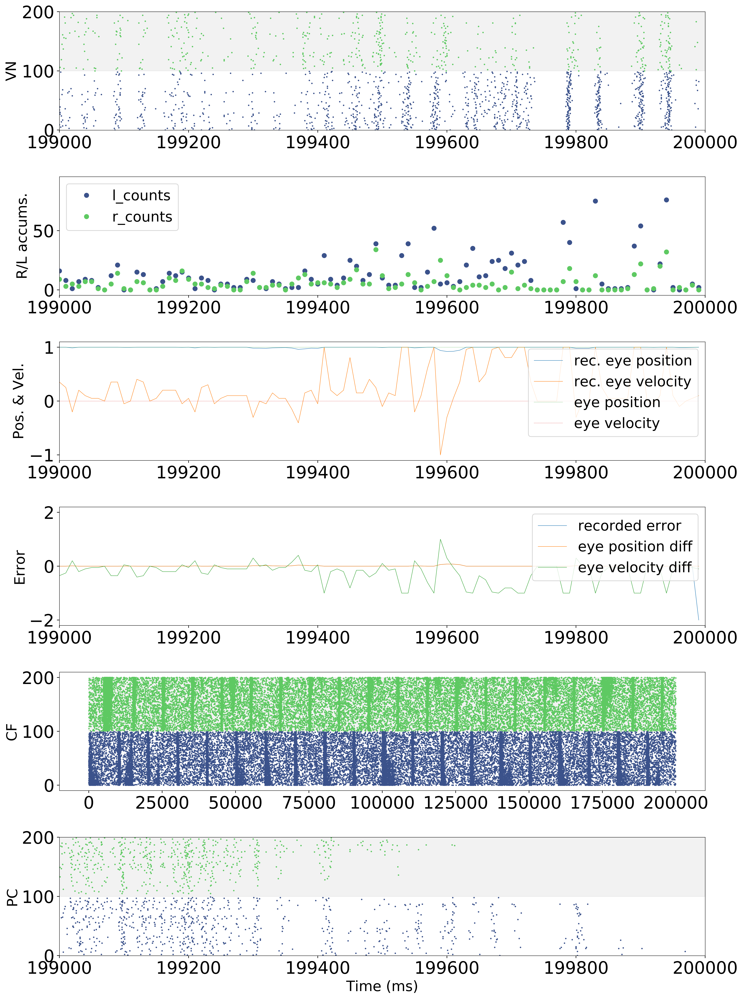

In [667]:
i = len(icub_snapshots)-1
diff = 1000
plot_results(results_dict=icub_snapshots[i], simulation_parameters=simulation_parameters,
             name="figures/cerebellum_icub_snap_{}_first_diff{}".format(i, suffix), all_spikes=all_spikes, xlim=[0, diff])
plot_results(results_dict=icub_snapshots[i], simulation_parameters=simulation_parameters,
             name="figures/cerebellum_icub_snap_{}_last_diff{}".format(i, suffix), all_spikes=all_spikes, xlim=[simtime-diff, simtime])

Plotting                                :figures/cerebellum_icub_full.png       
Plotting                                :figures/cerebellum_icub_full.pdf       


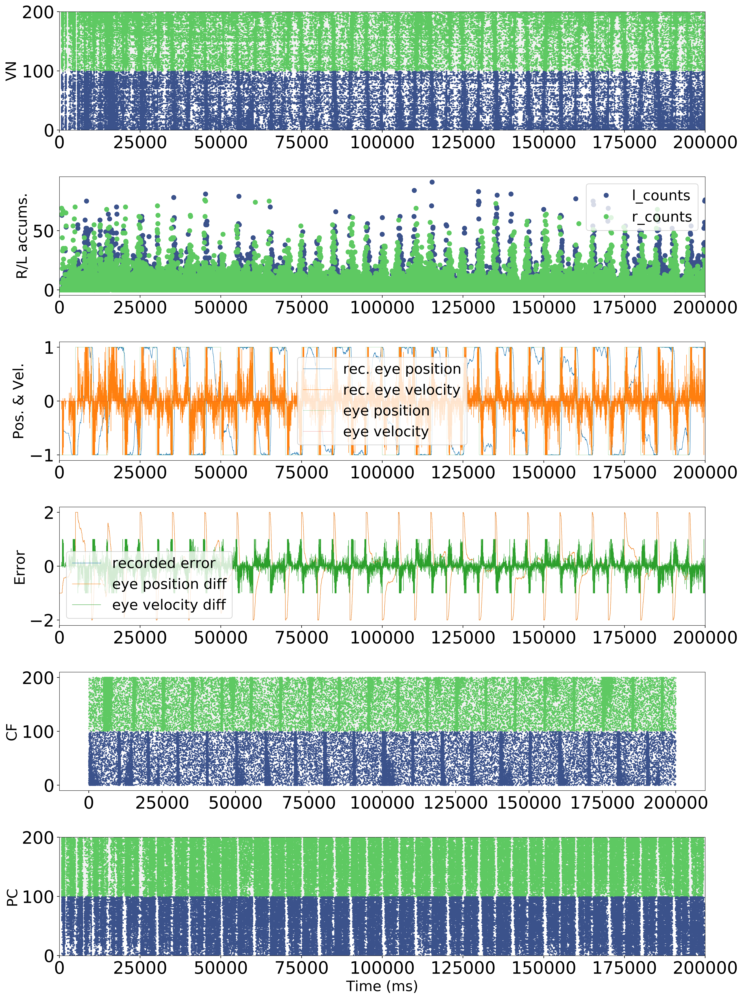

In [668]:
plot_results(results_dict=icub_snapshots[i], simulation_parameters=simulation_parameters,
             name="figures/cerebellum_icub_full{}".format(suffix), all_spikes=all_spikes)

# We need better info on the difference between L/R for VN

In [669]:
# unpacking results
errors = icub_snapshots[i]['errors']
l_counts = np.asarray(icub_snapshots[i]['l_counts']).ravel()
r_counts = np.asarray(icub_snapshots[i]['r_counts']).ravel()
rec_eye_pos = icub_snapshots[i]['rec_eye_pos']
rec_eye_vel = icub_snapshots[i]['rec_eye_vel']

# unpacking simulation params
runtime = simulation_parameters['runtime']
error_window_size = simulation_parameters['error_window_size']
vn_spikes = simulation_parameters['vn_spikes']
cf_spikes = simulation_parameters['cf_spikes']
perfect_eye_pos = simulation_parameters['perfect_eye_pos']
perfect_eye_vel = simulation_parameters['perfect_eye_vel']
vn_size = simulation_parameters['vn_size']
cf_size = simulation_parameters['cf_size']

In [670]:
diff_lr = l_counts - r_counts

### If the magnitude of the difference between L/R is approx 40 then the network should be able to perform a perfect motion if the gain is set to 40

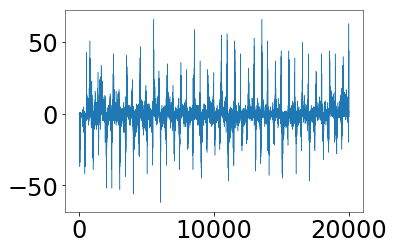

In [671]:
plt.plot(diff_lr)

In [672]:
icub_snapshots[-1].keys()

dict_keys(['r_counts', 'l_counts', 'errors', 'rec_eye_vel', 'rec_eye_pos'])

In [673]:
simulation_parameters.keys()

dict_keys(['rbls', 'argparser', 'run_end_time', 'git_hash', 'n_neurons_per_core', 'runtime', 'cf_size', 'wall_clock_script_run_time', 'wall_clock_sim_run_time', 'error_window_size', 'gain', 'perfect_eye_vel', 'cf_spikes', 'vn_size', 'vn_spikes', 'ss_neurons_per_core', 'perfect_eye_pos'])

(200,)


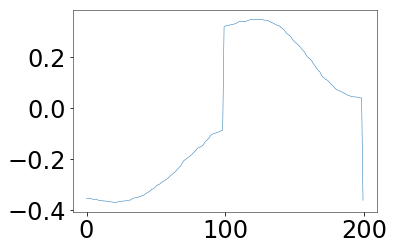

In [674]:
mae_window = 100
reshaped_error = errors.reshape(mae_window, errors.size//mae_window)
maes = np.mean(reshaped_error, axis=0)
print(maes.shape)
plt.plot(maes)

Plotting                                :figures/error_evolution.pdf            


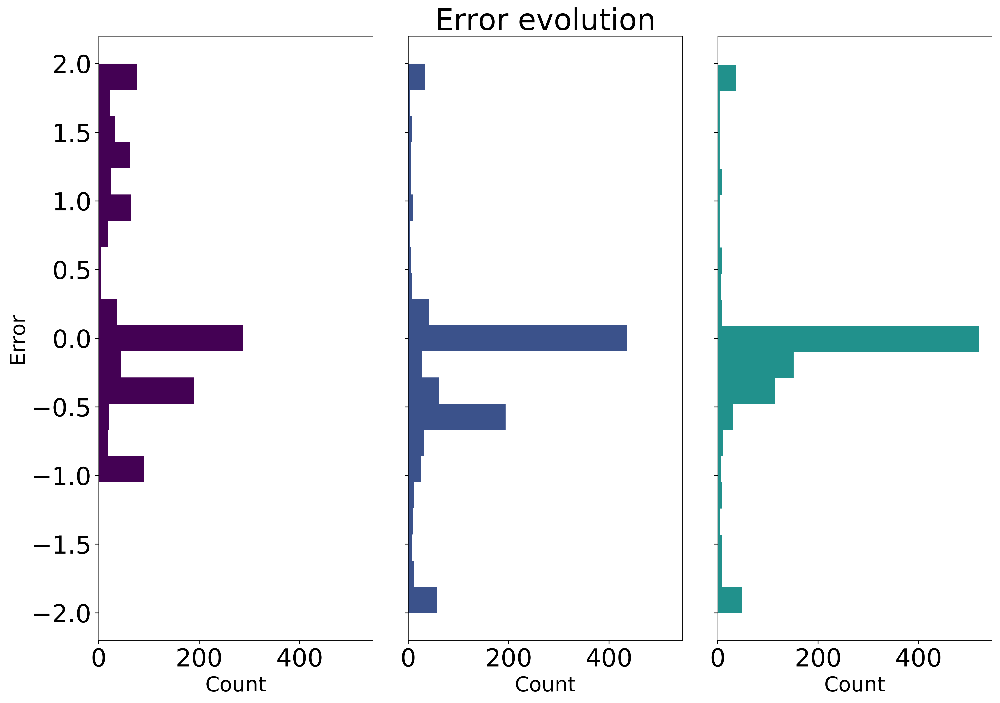

In [675]:
# Plot at 3 times during the simulation
f, axes = plt.subplots(1, 3,
                           figsize=(14, 10), sharey='row', sharex='row', dpi=400)
periods = [0, errors.size//2, errors.size-1000]


for index, curr_ax in enumerate(axes):
    curr_errors = errors[periods[index]:periods[index]+1000]
    curr_ax.hist(curr_errors,
                         color=viridis_cmap(index / (3 + 1)),
                         bins=21, rasterized=True, orientation='horizontal')
    if index == 0:
        curr_ax.set_ylabel("Error")
    if index == 1:
        curr_ax.set_title("Error evolution")
    curr_ax.set_xlabel("Count")


plt.tight_layout()
save_figure(
    plt,
    "figures/error_evolution{}".format(suffix),
    extensions=[".pdf", ])
plt.show()
plt.close(f)

In [676]:
def color_for_index(index, size, cmap=viridis_cmap):
    return cmap(1 / (size - index + 1))

In [677]:
perfect_eye_pos.shape

(10000,)

In [678]:
pattern_period = perfect_eye_pos.shape[0]  # in ms

(20,)


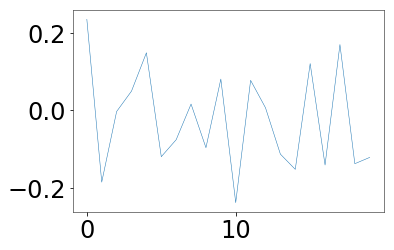

In [679]:
n_plots = runtime / (pattern_period)
error_windows_per_pattern = int(pattern_period / error_window_size)
reshaped_error = errors.reshape(errors.size//error_windows_per_pattern, error_windows_per_pattern)
maes = np.mean(reshaped_error, axis=1)
print(maes.shape)
plt.plot(maes)

In [680]:
reshaped_error.shape

(20, 1000)

Plotting                                :figures/bp_errors.png                  
Plotting                                :figures/bp_errors.pdf                  


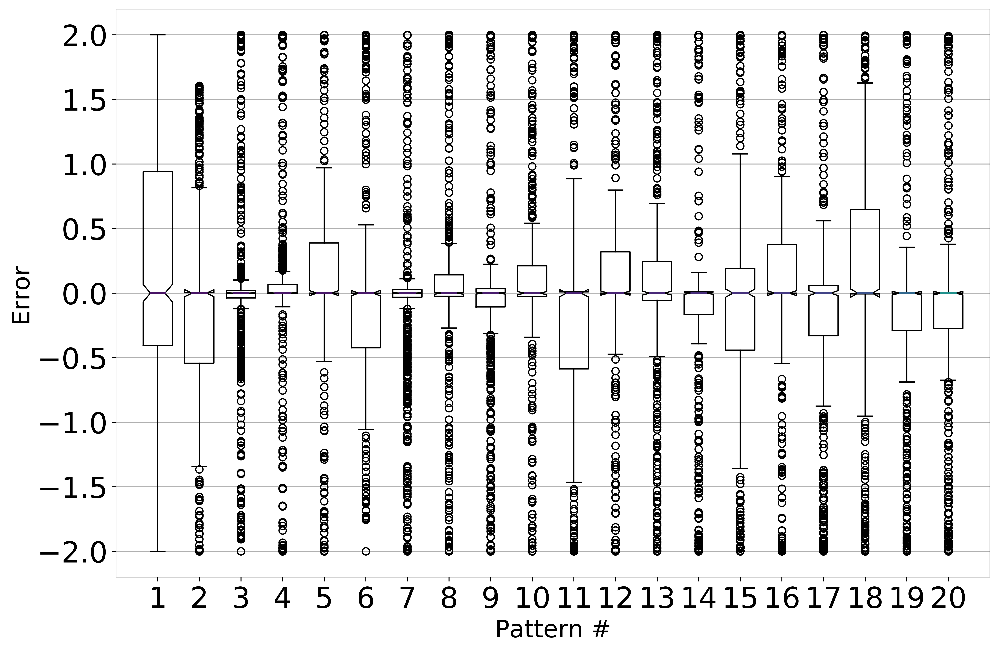

In [681]:
# Evolution of error
# print("Plotting boxplot for {} for all populations".format(variable_name))


bp_width = 0.7
f = plt.figure(figsize=(12, 8), dpi=600)
for index in np.arange(reshaped_error.shape[0]):
    curr_data = reshaped_error[index]
    plt.boxplot(curr_data, notch=True, positions=[index + 1],
                medianprops=dict(
                    color=color_for_index(index, n_plots),
                    linewidth=1.5),
                widths=bp_width
                )
plt.ylabel("Error")
plt.xlim([0, n_plots + 1])
plt.grid(True, which="major", axis="y")
plt.xlabel('Pattern #')
xtick_display_names = [str(int(x)) for x in np.arange(reshaped_error.shape[0])+1]
_, labels = plt.xticks(np.arange(n_plots) + 1, xtick_display_names)

f.tight_layout()
save_figure(plt, os.path.join(fig_folder,
                              "bp_errors{}".format(suffix)),
            extensions=['.png', '.pdf'])
plt.show()
plt.close(f)

Plotting                                :figures/error_std.png                  
Plotting                                :figures/error_std.pdf                  


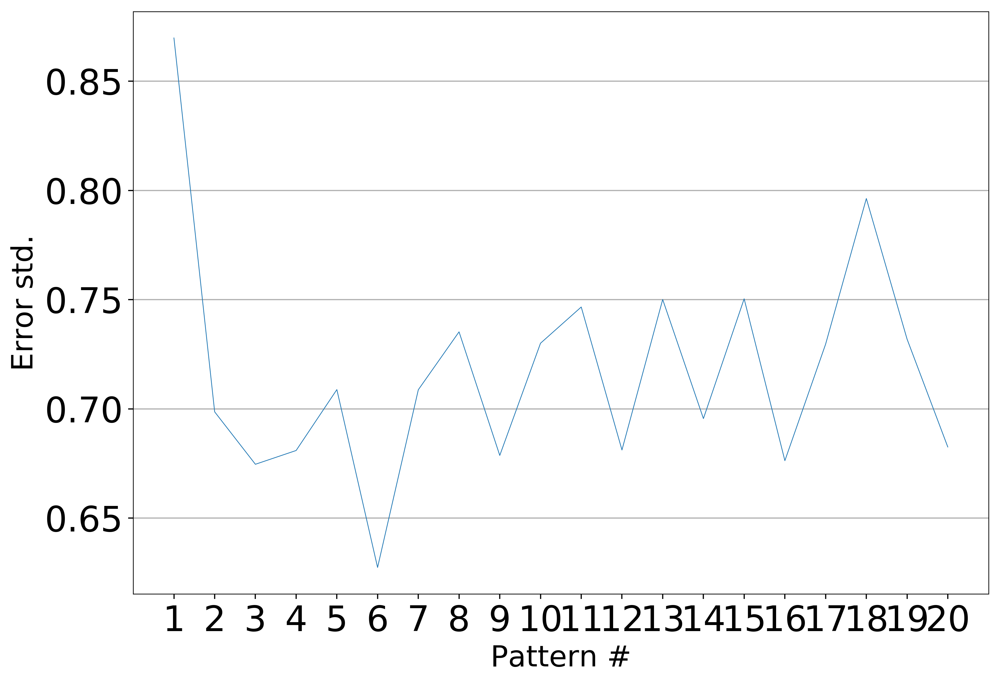

In [682]:
f = plt.figure(figsize=(10, 7), dpi=400)
plt.plot(np.arange(reshaped_error.shape[0])+1, np.std(reshaped_error, axis=1))
plt.ylabel("Error std.")
plt.xlim([0, n_plots + 1])
plt.grid(True, which="major", axis="y")
plt.xlabel('Pattern #')
xtick_display_names = [str(int(x)) for x in np.arange(reshaped_error.shape[0])+1]
_, labels = plt.xticks(np.arange(n_plots) + 1, xtick_display_names)

f.tight_layout()
save_figure(plt, os.path.join(fig_folder,
                              "error_std{}".format(suffix)),
            extensions=['.png', '.pdf'])
plt.show()
plt.close(f)

Plotting                                :figures/error_mae.png                  
Plotting                                :figures/error_mae.pdf                  


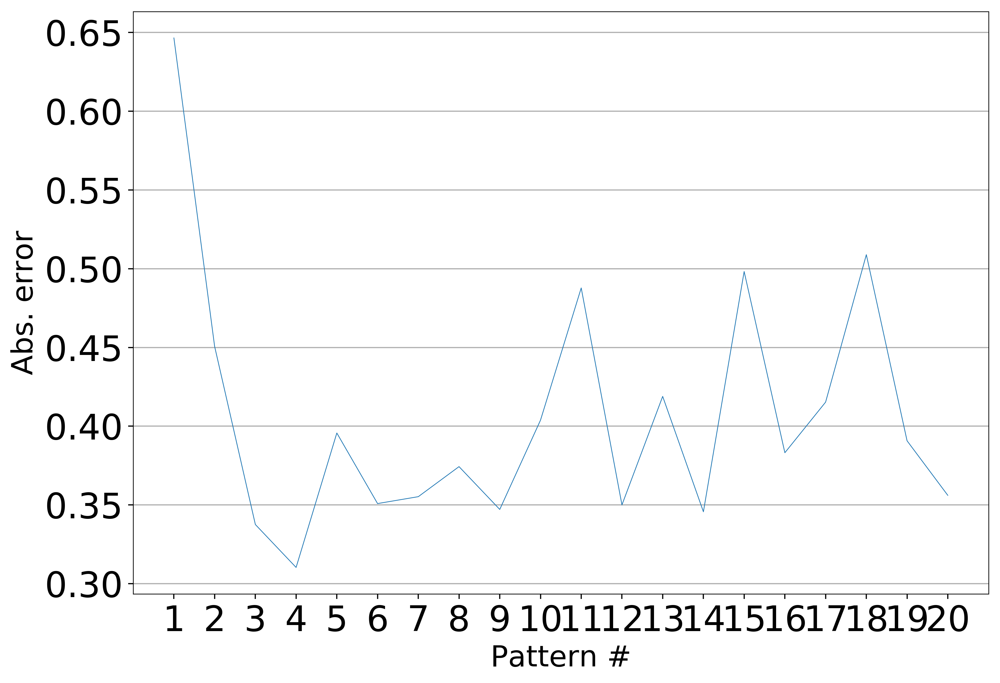

In [683]:
f = plt.figure(figsize=(10, 7), dpi=400)
plt.plot(np.arange(reshaped_error.shape[0])+1, np.mean(np.abs(reshaped_error), axis=1))
plt.ylabel("Abs. error")
plt.xlim([0, n_plots + 1])
plt.grid(True, which="major", axis="y")
plt.xlabel('Pattern #')
xtick_display_names = [str(int(x)) for x in np.arange(reshaped_error.shape[0])+1]
_, labels = plt.xticks(np.arange(n_plots) + 1, xtick_display_names)

f.tight_layout()
save_figure(plt, os.path.join(fig_folder,
                              "error_mae{}".format(suffix)),
            extensions=['.png', '.pdf'])
plt.show()
plt.close(f)

# What is happening to the weights in the network?

Order connections by their importance -- read, weight -- at the end of learning. Answer the following questions:
  - how stable are these weights?
  - how many different neurons do these weights belong to? (as in, are the highest weighted connections uniformly distributed between all post neurons)
  

In [686]:
len(final_connectivity['pf_pc'])

20

In [727]:
def list_to_weight_matrix(ff_conn, no_pre, no_post):
    conn_matrix = np.ones((no_pre, no_post)) * np.nan
    for s, t, w, d in ff_conn:
        s = int(s)
        t = int(t)
        conn_matrix[s, t] = w
    return conn_matrix

In [734]:
# Order connections by their weight at the end of learning
# Construct a weight matrix?
proj = 'pf_pc'
pre_pop = 'granule'
post_pop = 'purkinje'
ff_conn = final_connectivity[proj][-1]
no_w_snapshots = len(final_connectivity[proj])
conn_matrix = list_to_weight_matrix(ff_conn, all_neurons[pre_pop], all_neurons[post_pop])
delay_matrix = np.ones(conn_matrix.shape) * np.nan
for s, t, w, d in ff_conn:
    s = int(s)
    t = int(t)
    delay_matrix[s, t] = d

Plotting                                :figures/weight_matrix.png              


WARNING    /localhome/mbax3pb2/py3_venv/lib/python3.5/site-packages/matplotlib/figure.py:2369: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  warnings.warn("This figure includes Axes that are not compatible "
 [py.warnings]


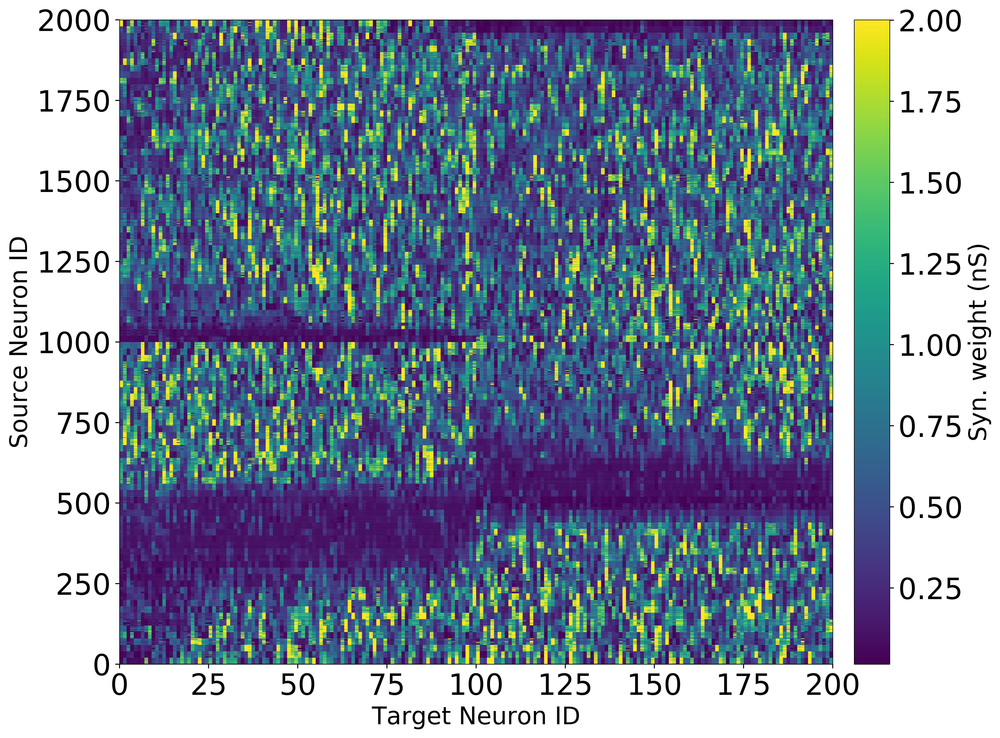

In [735]:
f = plt.figure(1, figsize=(12, 9), dpi=500)
packets_per_ts = other_recordings[pop]['packets']
im = plt.imshow(conn_matrix*1000,
                interpolation='none',
                extent=[0, all_neurons['purkinje'],
                        0, all_neurons['granule']],
                origin='lower')
ax = plt.gca()
ax.set_aspect('auto')
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", "5%", pad="3%")
cbar = plt.colorbar(im, cax=cax)
cbar.set_label("Syn. weight (nS)")

ax.set_xlabel("Target Neuron ID")
ax.set_ylabel("Source Neuron ID")

save_figure(plt, os.path.join('figures/',
                              "weight_matrix{}".format(suffix)),
            #                         extensions=['.png', '.pdf'])
            extensions=['.png', ])
plt.show()
plt.close(f)

Plotting                                :figures/delay_matrix.png               


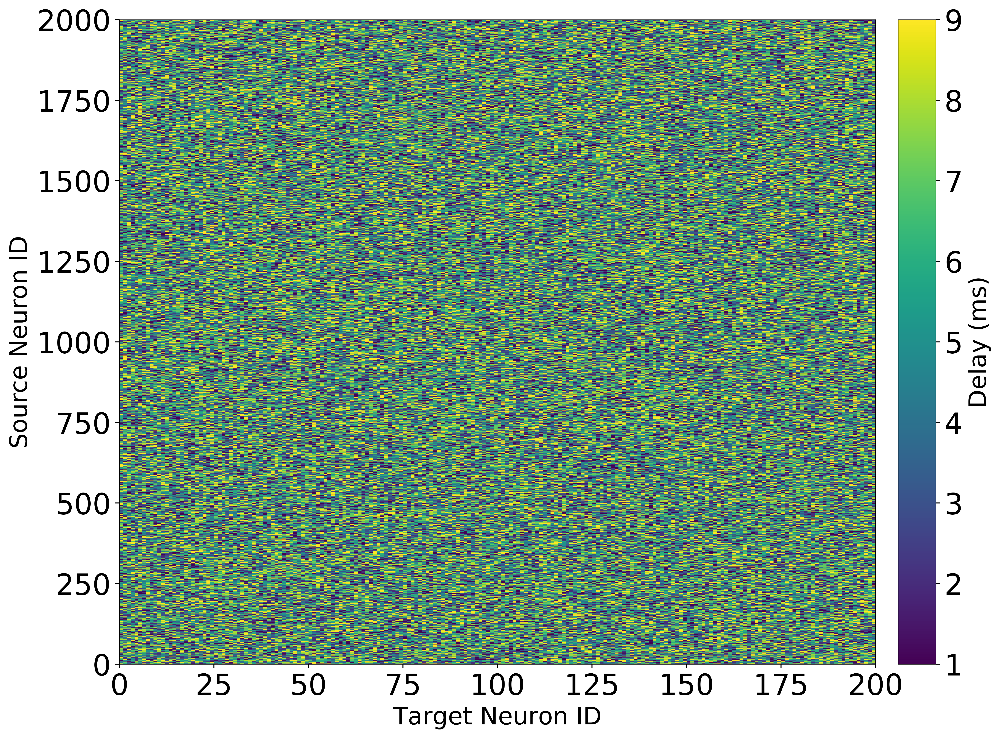

In [736]:
f = plt.figure(1, figsize=(12, 9), dpi=500)
packets_per_ts = other_recordings[pop]['packets']
im = plt.imshow(delay_matrix,
                interpolation='none',
                extent=[0, all_neurons['purkinje'],
                        0, all_neurons['granule']],
                origin='lower')
ax = plt.gca()
ax.set_aspect('auto')
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", "5%", pad="3%")
cbar = plt.colorbar(im, cax=cax)
cbar.set_label("Delay (ms)")

ax.set_xlabel("Target Neuron ID")
ax.set_ylabel("Source Neuron ID")

save_figure(plt, os.path.join('figures/',
                              "delay_matrix{}".format(suffix)),
            #                         extensions=['.png', '.pdf'])
            extensions=['.png', ])
plt.show()
plt.close(f)

Mean weight for this side: 0.0006121274089813233
Mean weight for this side: 0.0006273967361450195
Plotting                                :figures/LR_pf_pc_weight_histogram_snap.png


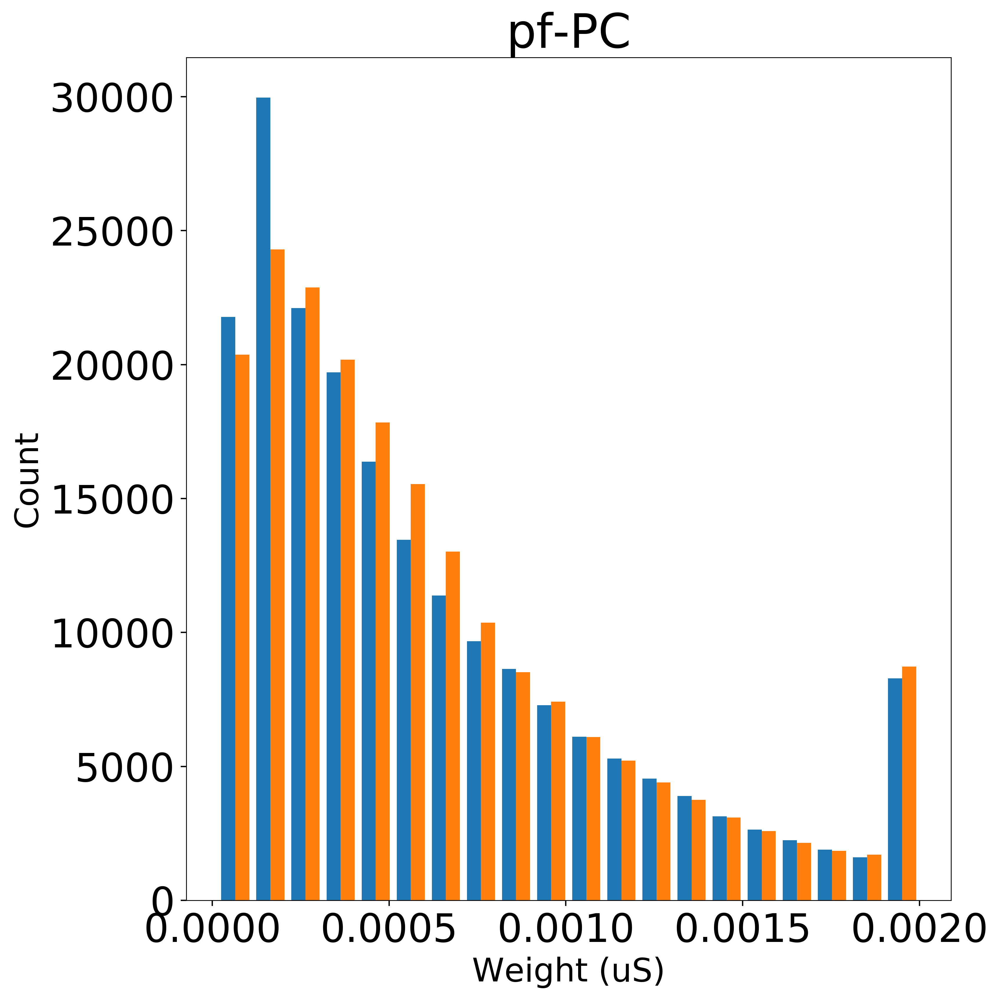

In [737]:
# Look at each half at a time
pop = "purkinje"
proj = "pf_pc"
pop_split = conn_matrix.shape[1] // 2
weights_per_mc = []
for pop_i in range(2):
    weights_per_mc.append(conn_matrix[:, pop_i*pop_split:(pop_i+1)*pop_split].ravel())
    
    print("Mean weight for this side:", np.mean(weights_per_mc[-1]))
    
# For all to all connectivity this should hold
if np.all(np.isfinite(conn_matrix)):
    assert weights_per_mc[0].size == weights_per_mc[1].size 
    

    
f = plt.figure(1, figsize=(9, 9), dpi=400)
plt.hist(weights_per_mc, bins=20)
plt.title(use_display_name(proj))
plt.xlabel("Weight (uS)")
plt.ylabel("Count")
save_figure(plt, os.path.join(fig_folder, "LR_{}_weight_histogram_snap{}".format(proj, suffix)),
            extensions=['.png', ])
plt.show()
plt.close(f)

In [745]:
# Now sort the connections (source, target) in decending order of their weight. 
# I hypothesise that the strongest weights at the end are also the most stable ones.
track_no = 10
individual_track_id = np.arange(track_no)
the_tracks = []

for pop_i in range(2):
    target_offset = pop_i*pop_split
    target_end = (pop_i+1)*pop_split
    ascending_sources, ascending_targets = np.unravel_index(np.argsort(conn_matrix[:, target_offset:target_end], axis=None), 
                                                            conn_matrix[:, target_offset:target_end].shape)
    descending_sources = ascending_sources[::-1]
    descending_targets = ascending_targets[::-1] + target_offset
    print(np.max(descending_sources), np.max(descending_targets))
    print(descending_sources, descending_targets)
    tracked_src = descending_sources[:track_no]
    tracked_trg = descending_targets[:track_no]
    print("TRACKED:", tracked_src, tracked_trg)
    # Now go through each weight snapshot and find the weight for each of the tracked weights
    tracked_weights = np.ones((track_no, no_w_snapshots)) * np.nan
    for snapshot_i in range(no_w_snapshots):
        snap_ws = final_connectivity[proj][snapshot_i]
        snap_w_matrix = list_to_weight_matrix(snap_ws, all_neurons[pre_pop], all_neurons[post_pop])
        tracked_weights_snap = snap_w_matrix[tracked_src, tracked_trg]
        # Store tracked weights
        tracked_weights[:, snapshot_i] = tracked_weights_snap.ravel()
        
    the_tracks.append(tracked_weights)
    

1999 99
[ 999 1614  701 ...  219  120   28] [99 98 95 ...  0 41  5]
TRACKED: [ 999 1614  701  702 1253 1614 1253 1614 1614  702] [99 98 95  1 40 67 29 78 85 66]
1999 199
[ 999 1158 1158 ...  507 1997 1139] [199 149 144 ... 180 106 188]
TRACKED: [ 999 1158 1158 1158 1158 1158 1158 1157 1157 1157] [199 149 144 140 126 115 112 193 184 154]


Plotting                                :figures/top_weight_evo.pdf             


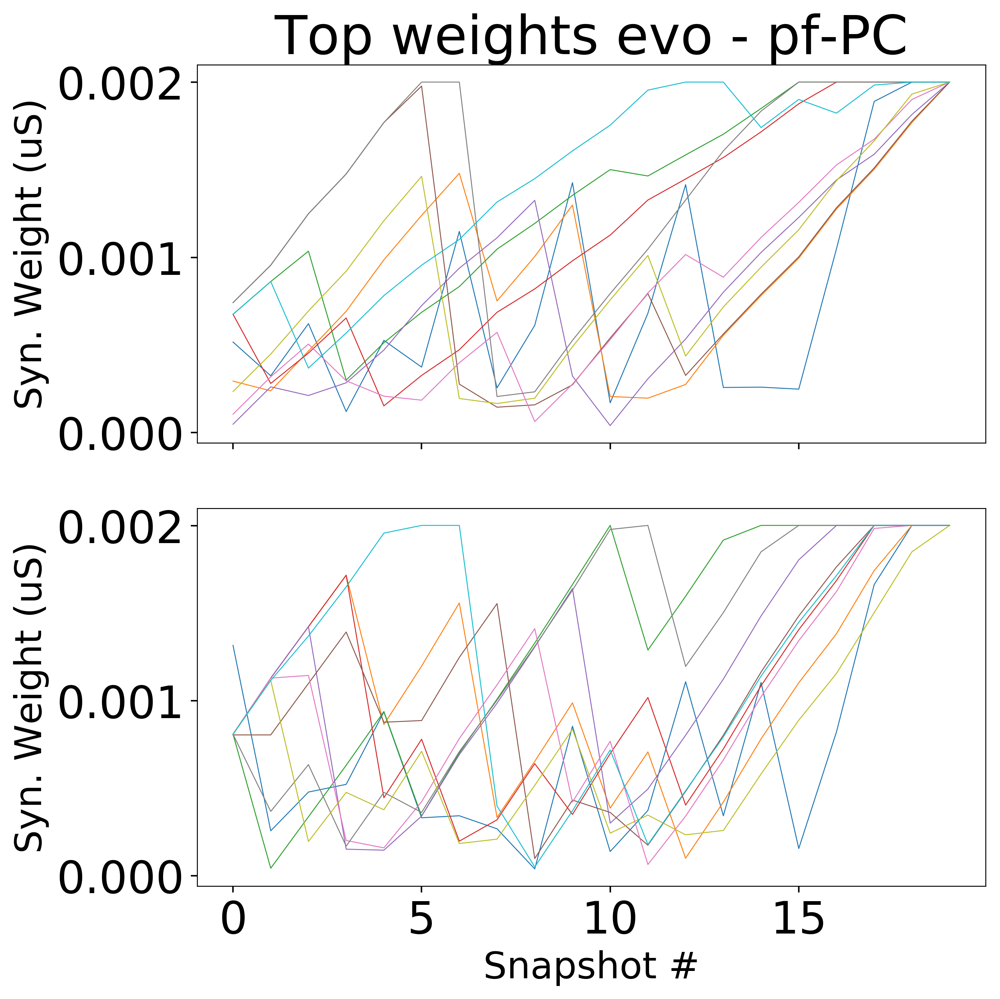

In [751]:
f, axes = plt.subplots(2, 1,
                           figsize=(8, 8), dpi=400, sharey='all', sharex='all')

for pop_i in range(2):
    tracked_weights = the_tracks[pop_i]
    for i in individual_track_id:
        axes[pop_i].plot(tracked_weights[i, :])
    axes[pop_i].set_ylabel("Syn. Weight (uS)")
    if pop_i == 0:
        axes[pop_i].set_title("Top weights evo - " + use_display_name(proj))
    if pop_i == 1:
        axes[pop_i].set_xlabel("Snapshot #")
    

plt.tight_layout()
save_figure(
    plt,
    "figures/top_weight_evo{}".format(suffix),
    extensions=[".pdf", ])
plt.show()
plt.close(f)

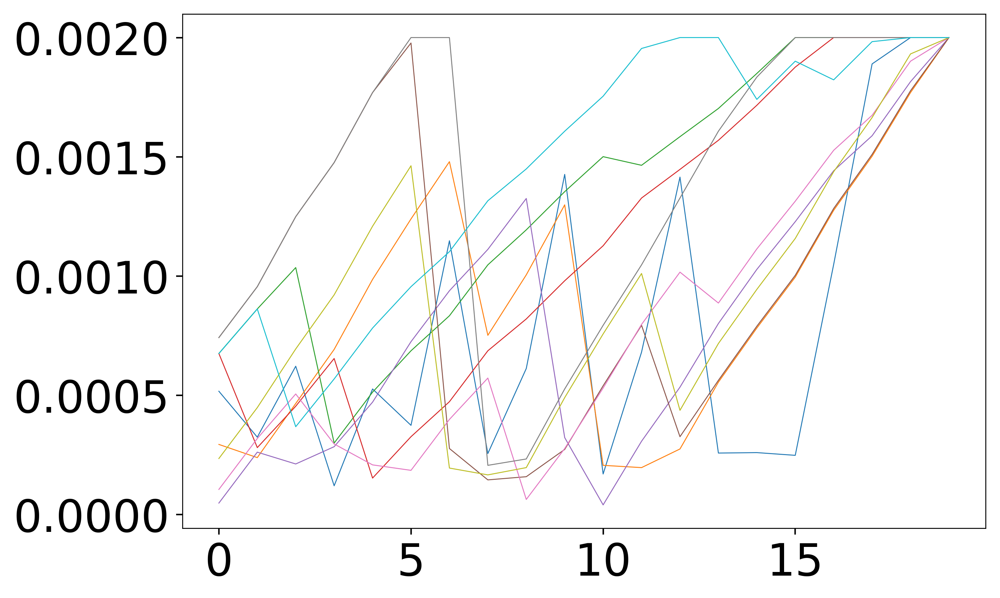

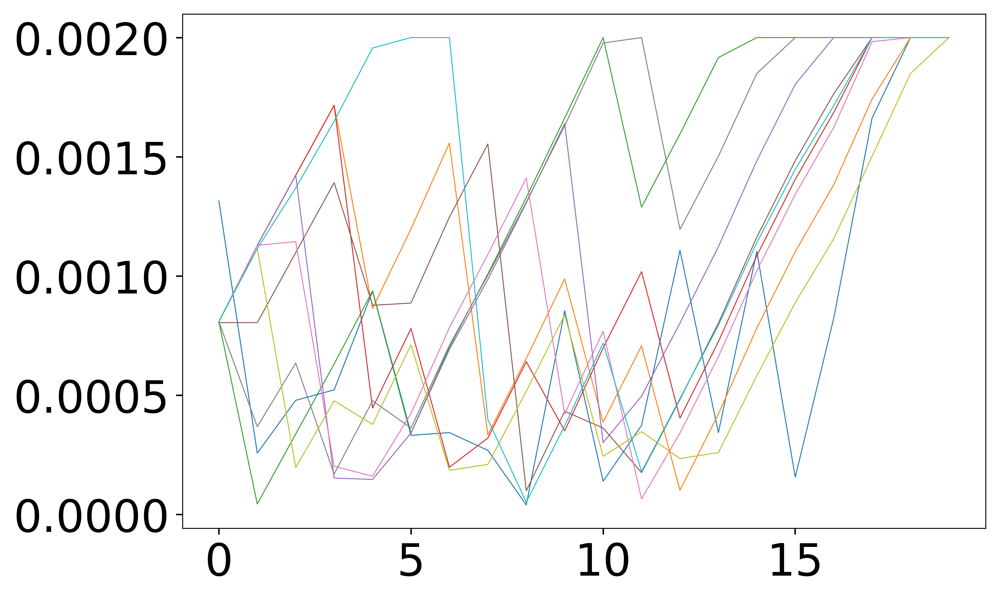

In [746]:
for pop_i in range(2):
    tracked_weights = the_tracks[pop_i]
    f = plt.figure(figsize=(8, 5), dpi=400)
    for i in individual_track_id:
        plt.plot(tracked_weights[i, :])
    plt.show()

# We need better info on the activity arriving at PCs to balance pf-PC excitation with LTP/LTD

In [587]:
grc_spikes = all_spikes['granule'][:, 1]
grc_neurons = all_neurons['granule']

In [588]:
# Firing rate of the GrC pop
grc_spikes.shape[0] / (simtime*ms)

4.09303 * khertz

In [589]:
# Firing rate of the average GrC neuron
grc_spikes.shape[0] / (grc_neurons*simtime*ms)

2.046515 * hertz

Plotting                                :figures/spikes_produced_per_pop_mossy_fibres.png


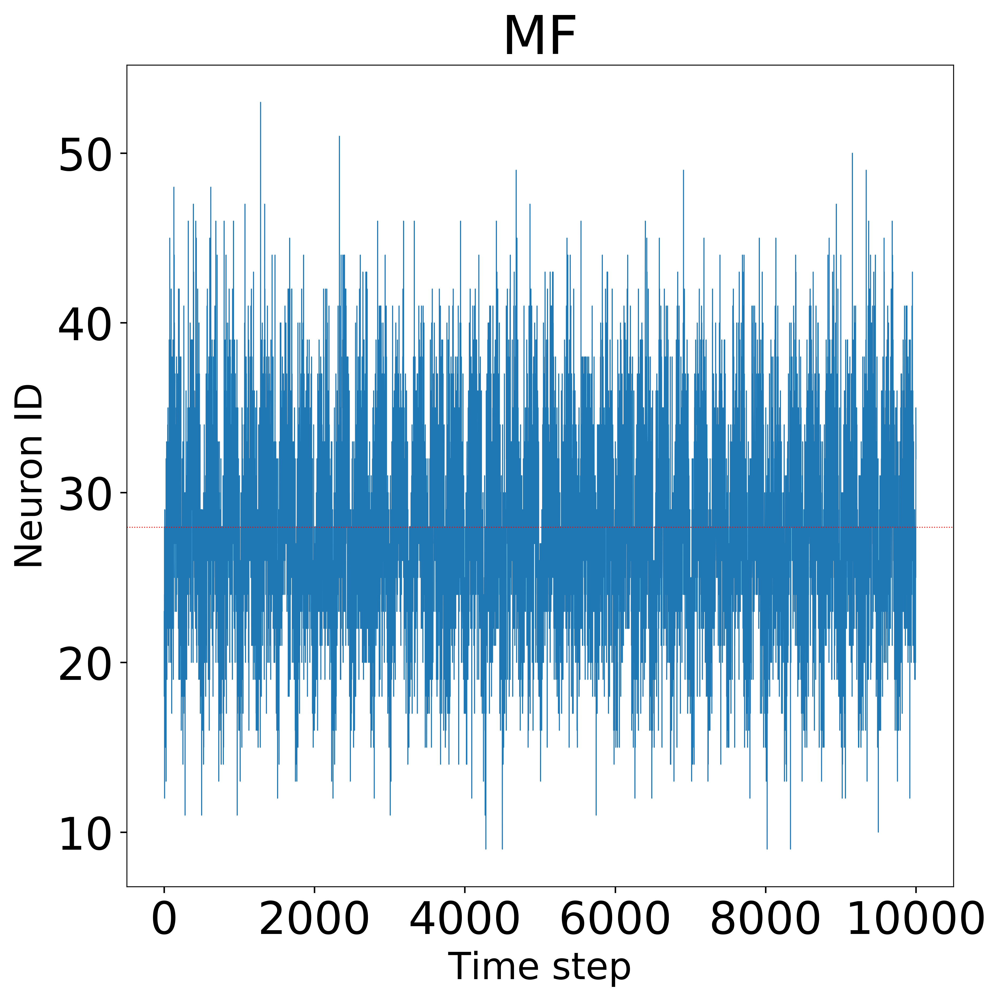

Plotting                                :figures/hist_spikes_produced_per_pop_mossy_fibres.png


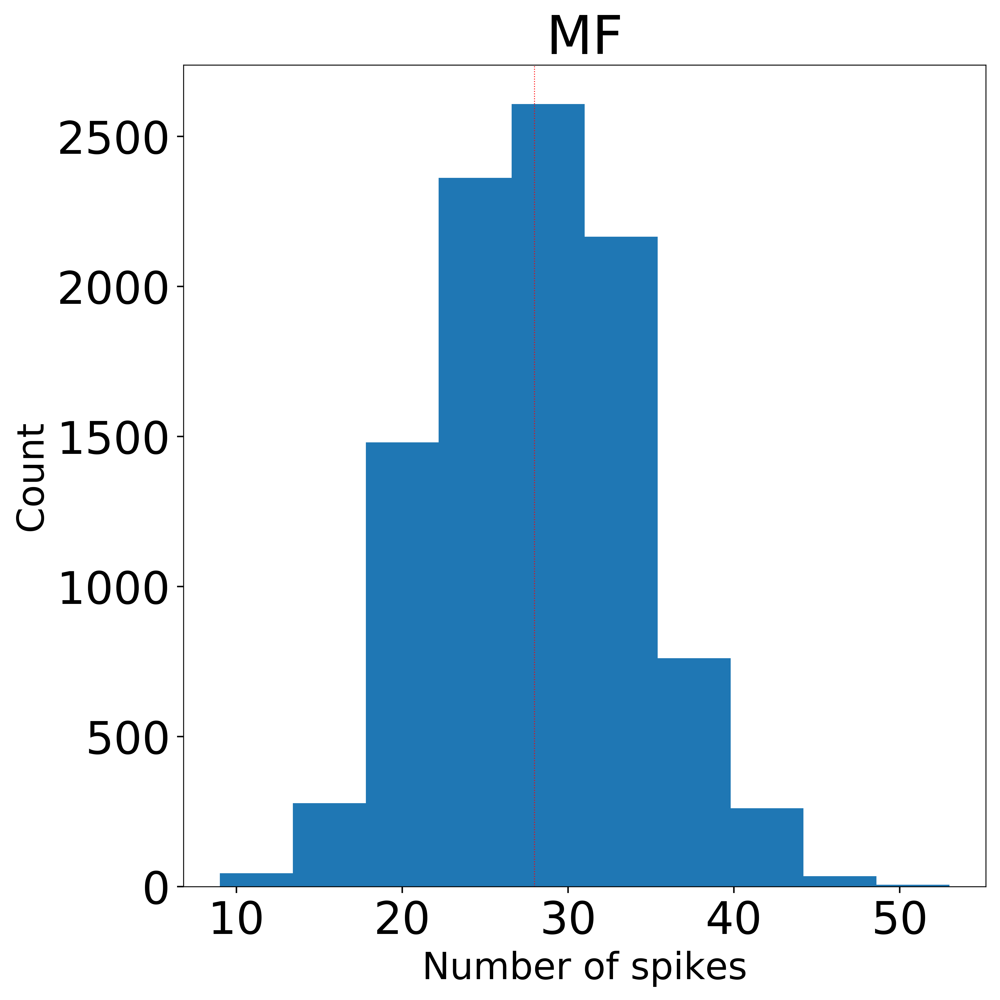

Plotting                                :figures/spikes_produced_per_pop_granule.png


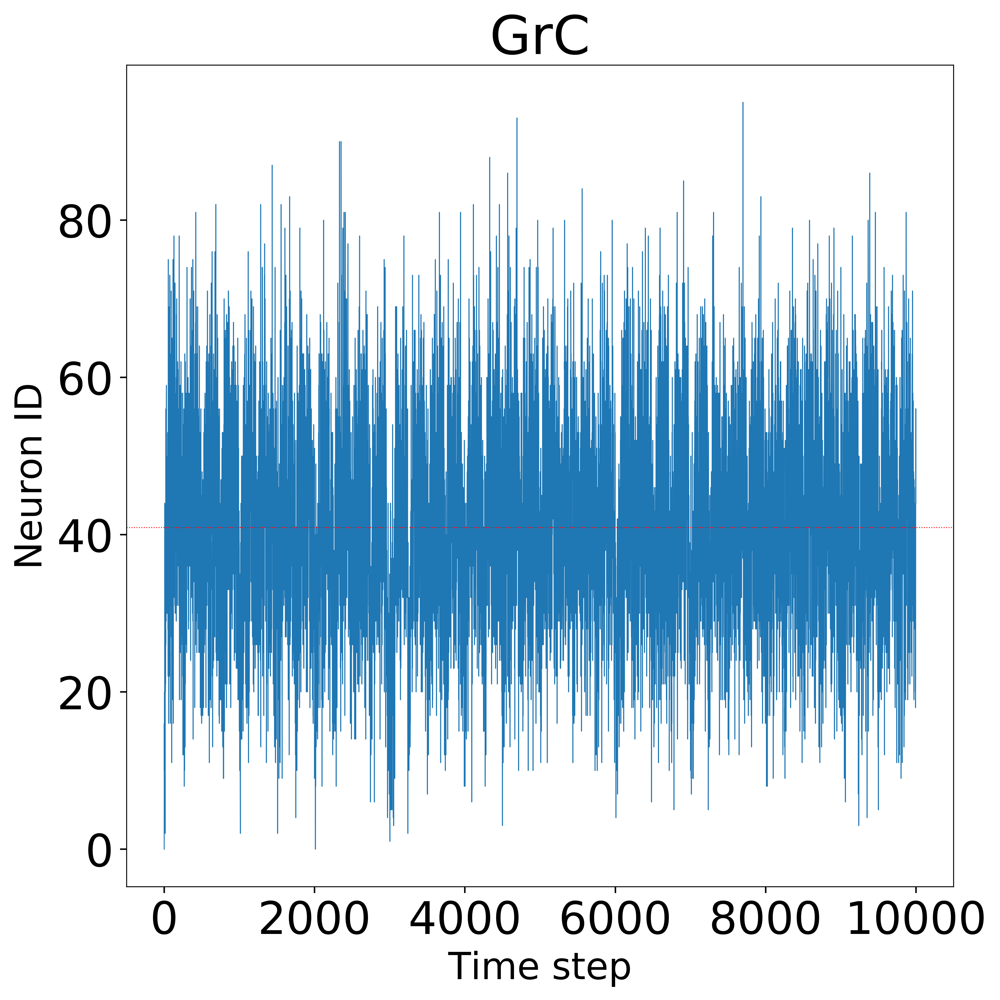

Plotting                                :figures/hist_spikes_produced_per_pop_granule.png


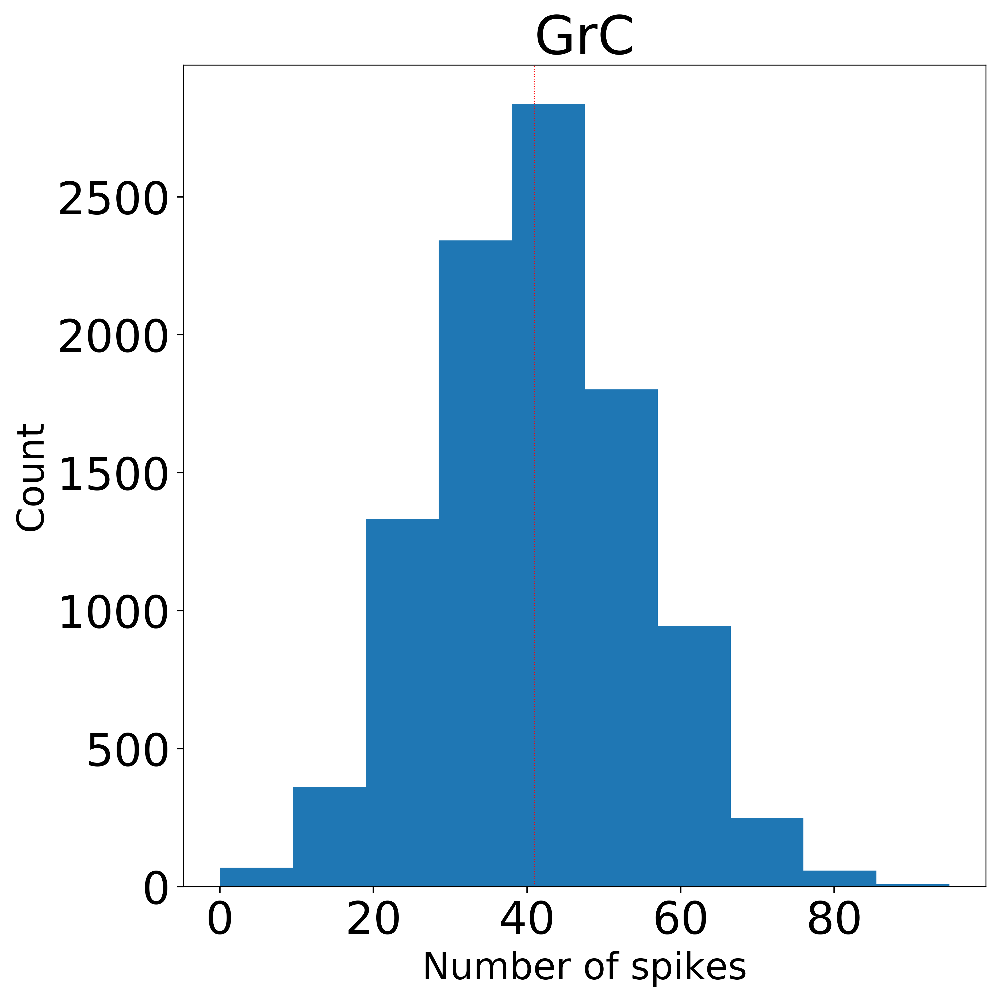

Plotting                                :figures/spikes_produced_per_pop_golgi.png


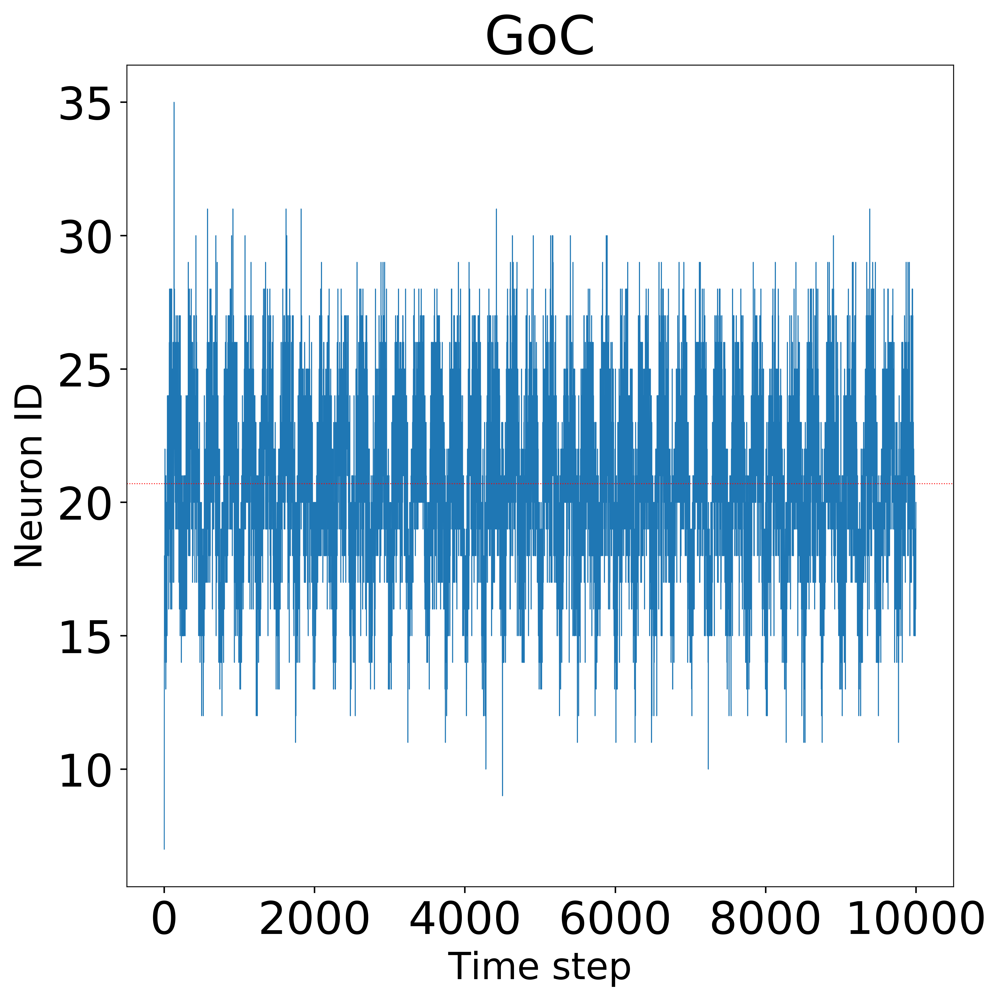

Plotting                                :figures/hist_spikes_produced_per_pop_golgi.png


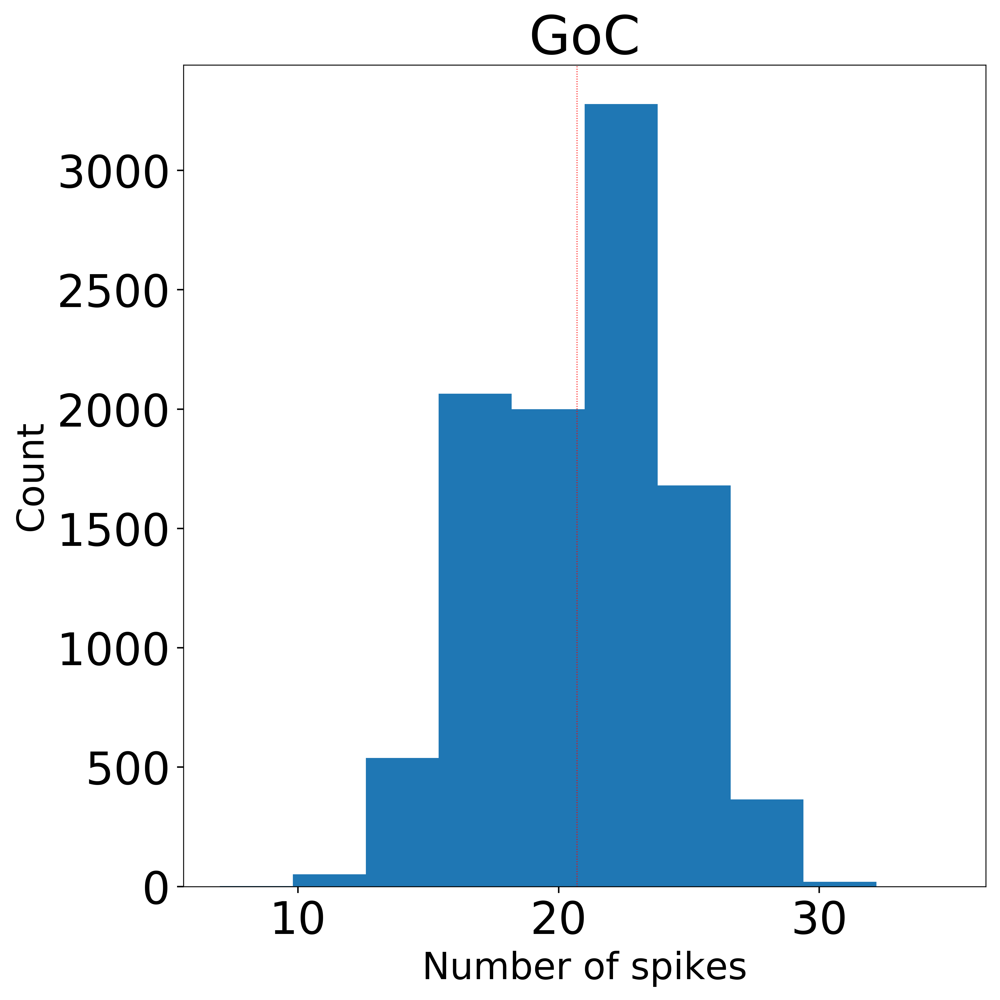

Plotting                                :figures/spikes_produced_per_pop_purkinje.png


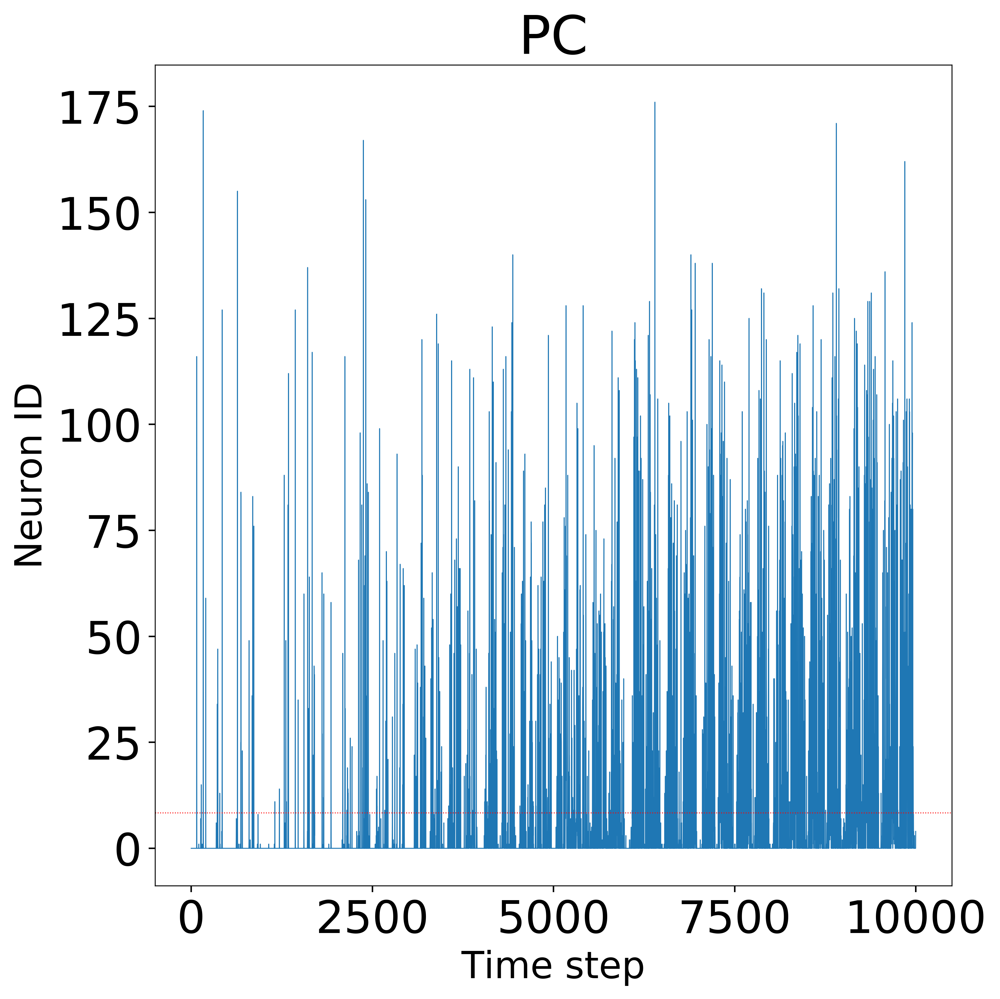

Plotting                                :figures/hist_spikes_produced_per_pop_purkinje.png


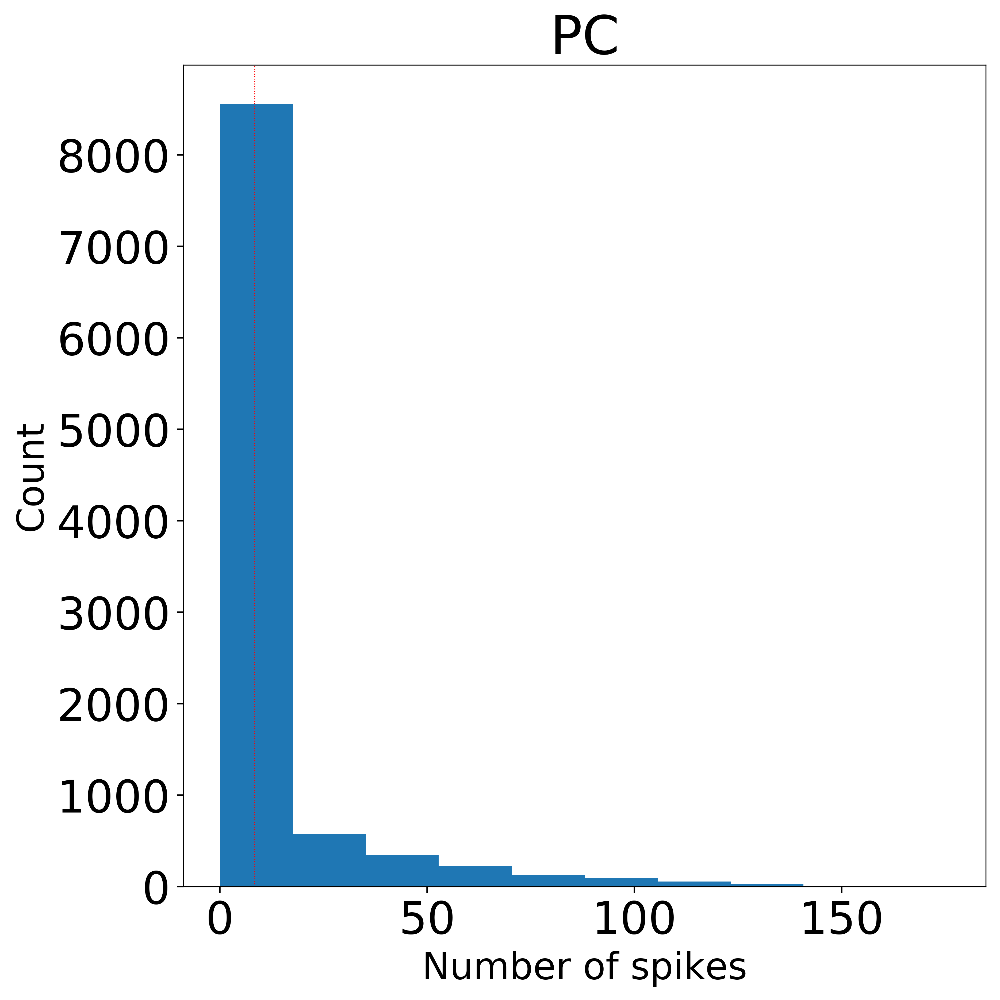

Plotting                                :figures/spikes_produced_per_pop_climbing_fibres.png


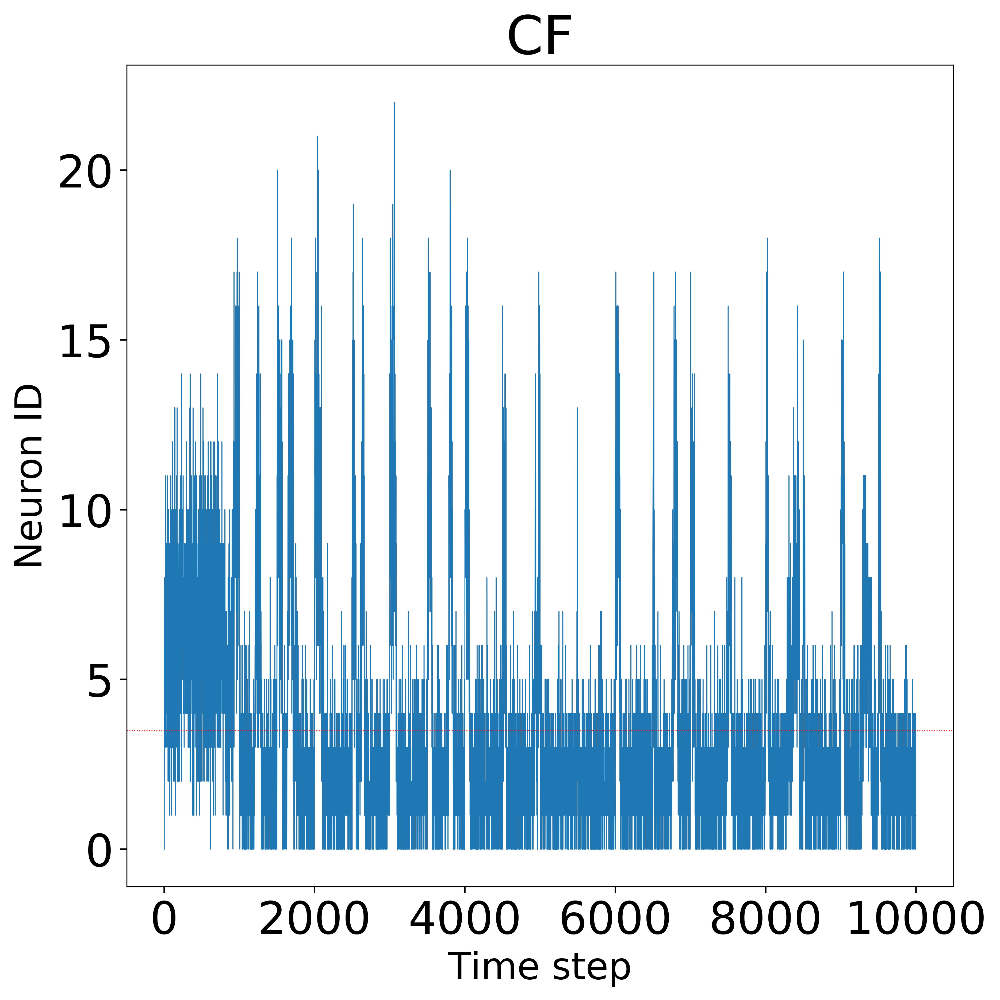

Plotting                                :figures/hist_spikes_produced_per_pop_climbing_fibres.png


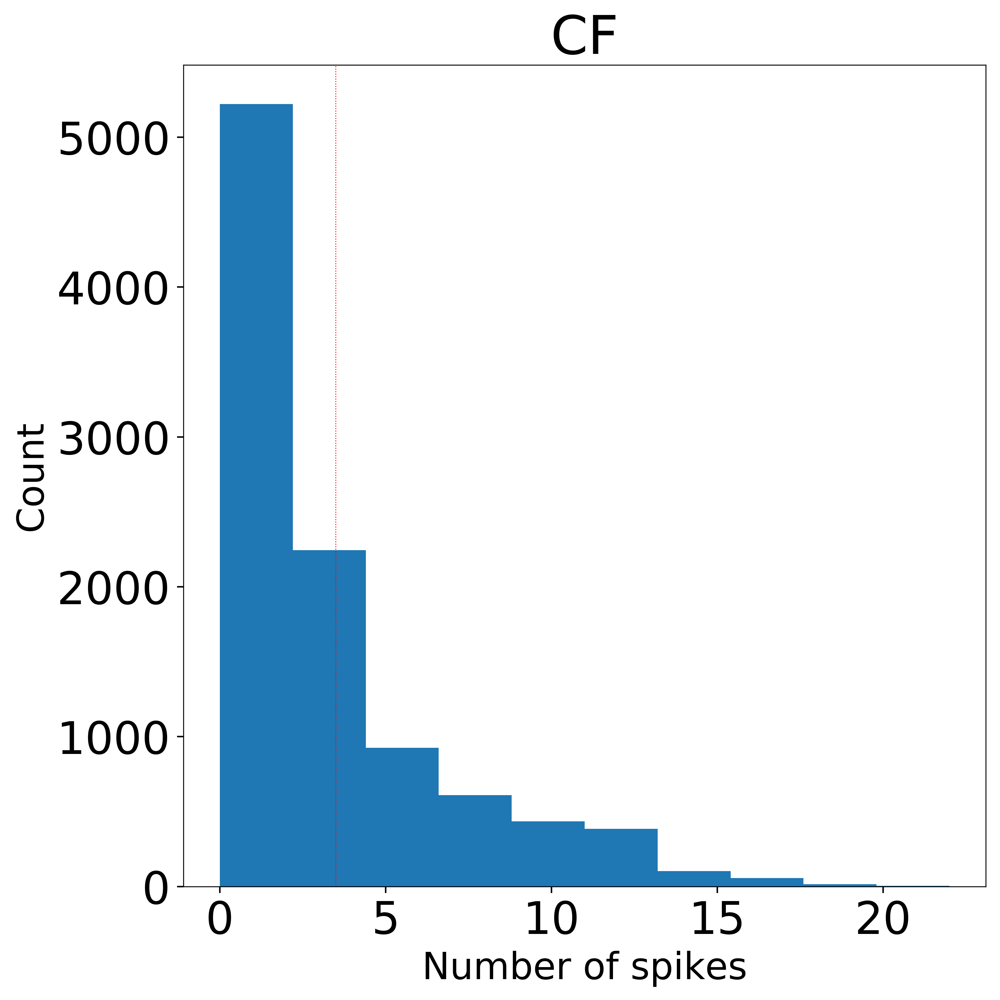

Plotting                                :figures/spikes_produced_per_pop_vn.png 


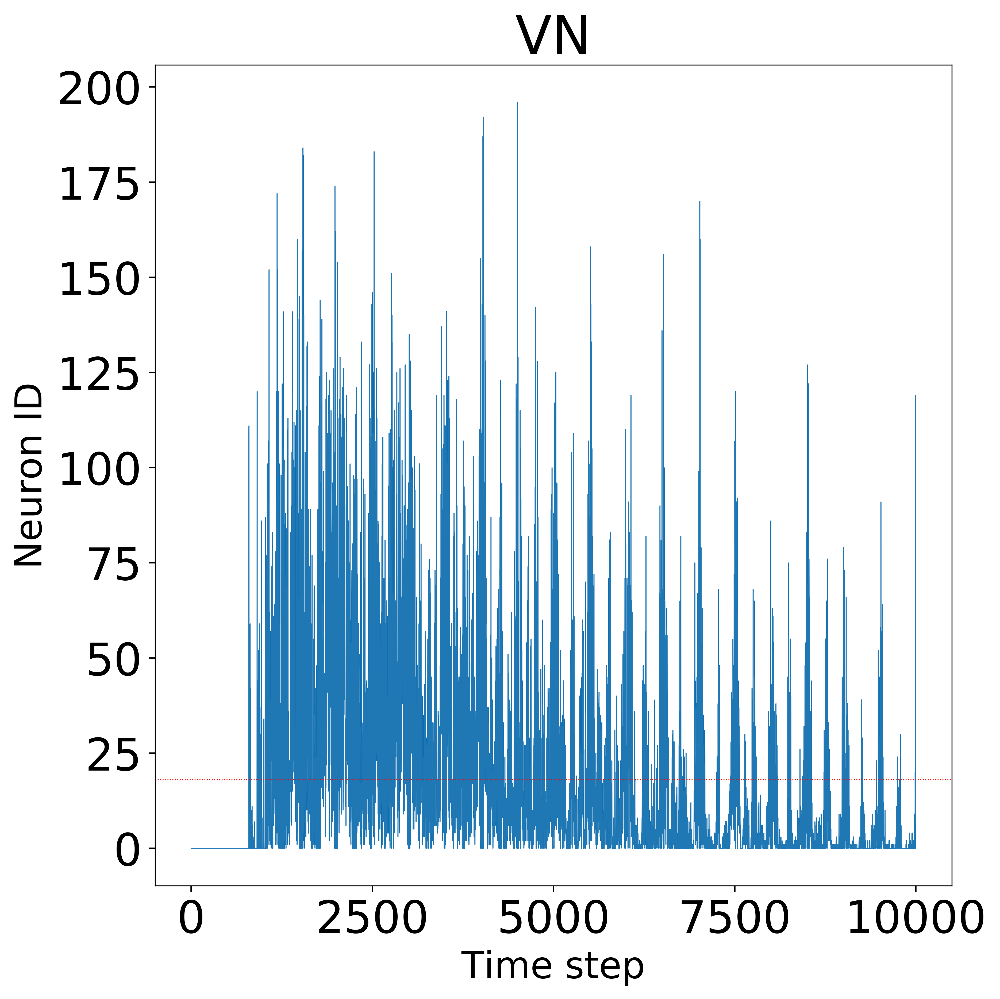

Plotting                                :figures/hist_spikes_produced_per_pop_vn.png


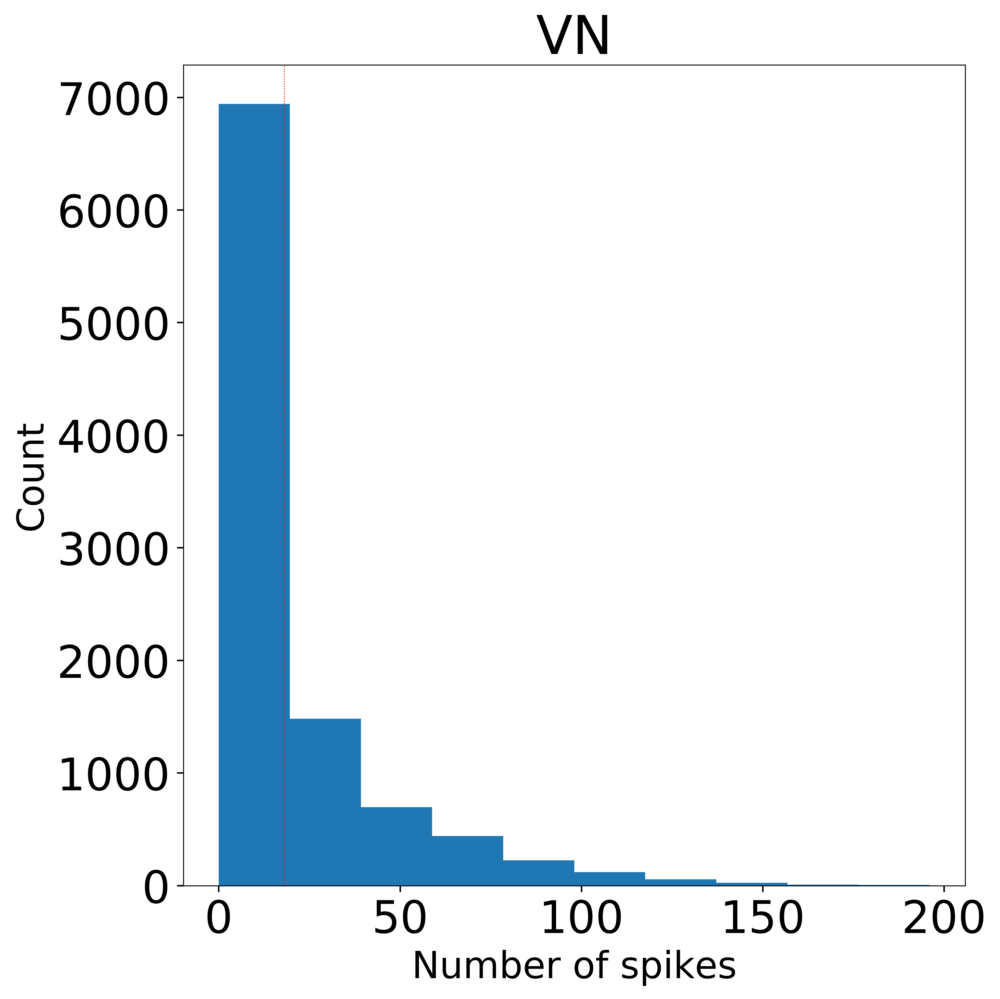

In [590]:
# for each window in simtime // error_window_size compute the firing rate of the pop of GrC. 
for pop in plot_order:
    spikes_times_for_pop = all_spikes[pop][:, 1]
    pop_firing_rate_avg = np.empty(simtime // error_window_size)
    for window in range(simtime // error_window_size):
        w_start = window * error_window_size
        w_end = (window + 1) * error_window_size 
        spikes_in_window = np.logical_and(
                spikes_times_for_pop >= w_start,
                spikes_times_for_pop < w_end)
        spikes_produced_by_pop = np.count_nonzero(spikes_in_window)
        pop_firing_rate_avg[window] = spikes_produced_by_pop
        
    # Plotting 
    f = plt.figure(1, figsize=(8, 8), dpi=500)
    plt.plot(pop_firing_rate_avg)
    plt.axhline(np.mean(pop_firing_rate_avg), color="r", ls=":")
    plt.xlabel("Time step")
    plt.ylabel("Neuron ID")
    plt.title(use_display_name(pop))

    save_figure(plt, os.path.join('figures/',
                                  "spikes_produced_per_pop_{}".format(pop)),
                #                         extensions=['.png', '.pdf'])
                extensions=['.png', ])
    plt.show()
    plt.close(f)
    # Hist plot
    f = plt.figure(1, figsize=(8, 8), dpi=500)
    plt.hist(pop_firing_rate_avg)
    plt.axvline(np.mean(pop_firing_rate_avg), color="r", ls=":")

    plt.xlabel("Number of spikes")
    plt.ylabel("Count")
    plt.title(use_display_name(pop))

    save_figure(plt, os.path.join('figures/',
                                  "hist_spikes_produced_per_pop_{}".format(pop)),
                #                         extensions=['.png', '.pdf'])
                extensions=['.png', ])
    plt.show()
    plt.close(f)

Plotting                                :figures/active_neurons_per_pop_mossy_fibres.png


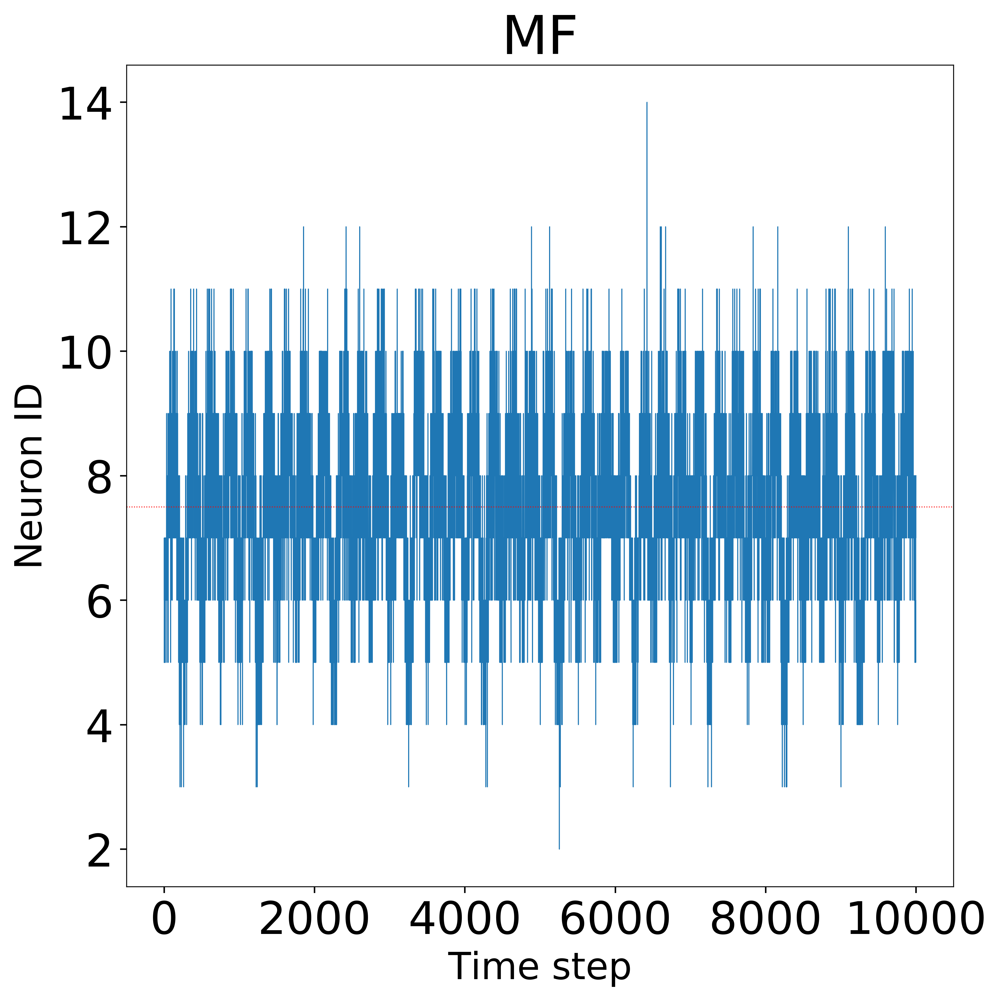

Plotting                                :figures/hist_active_neurons_per_pop_mossy_fibres.png


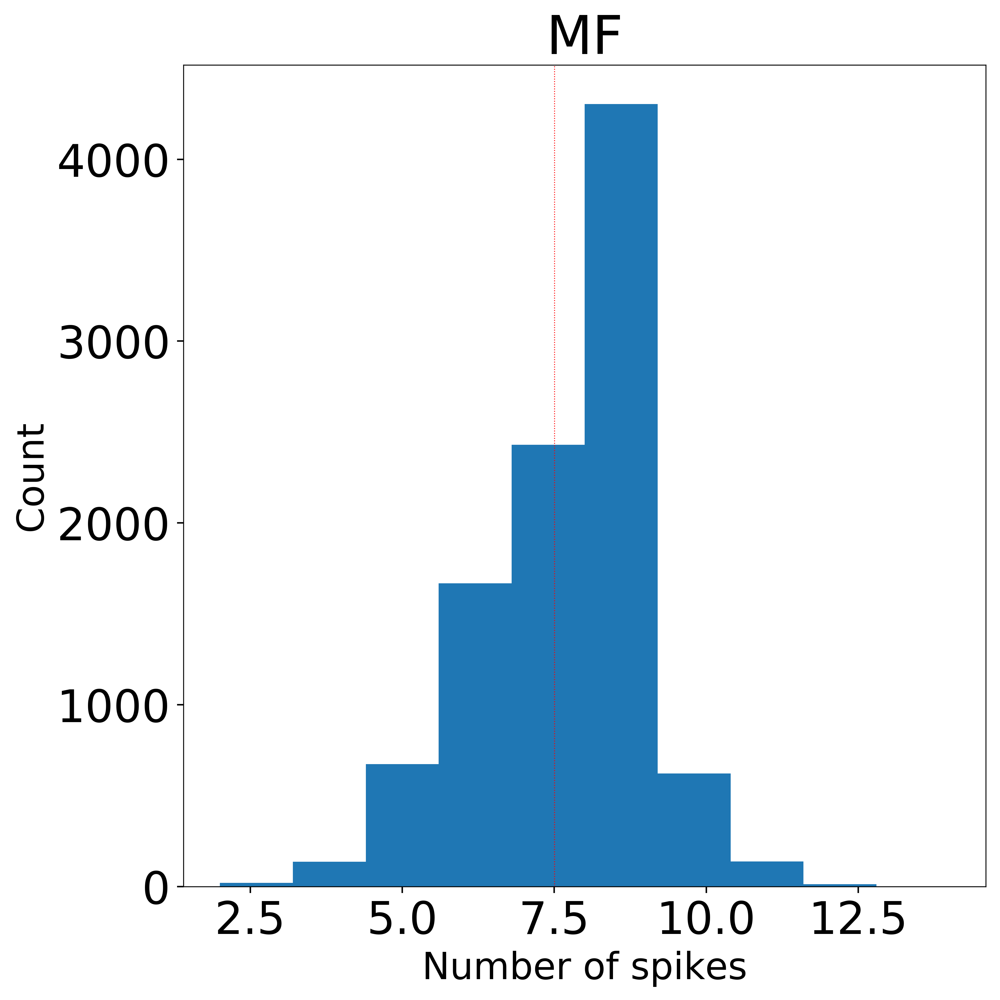

Plotting                                :figures/active_neurons_per_pop_granule.png


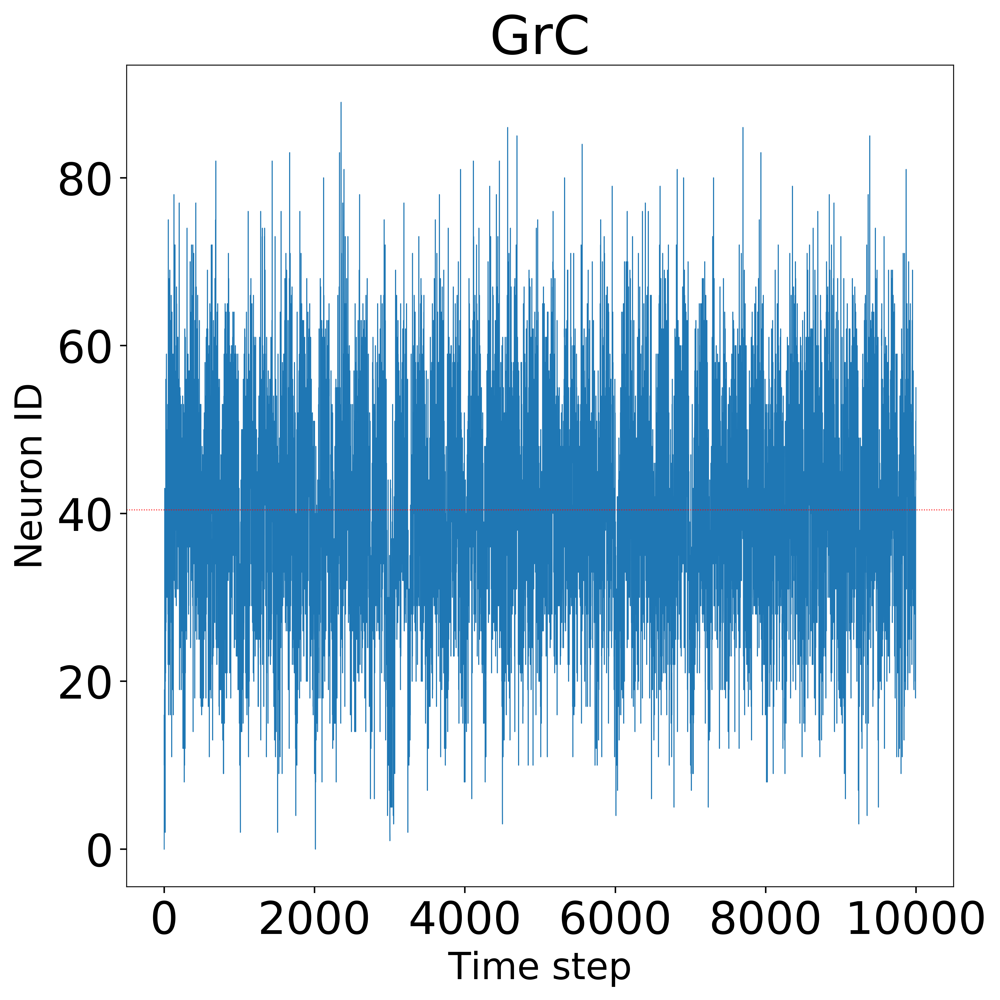

Plotting                                :figures/hist_active_neurons_per_pop_granule.png


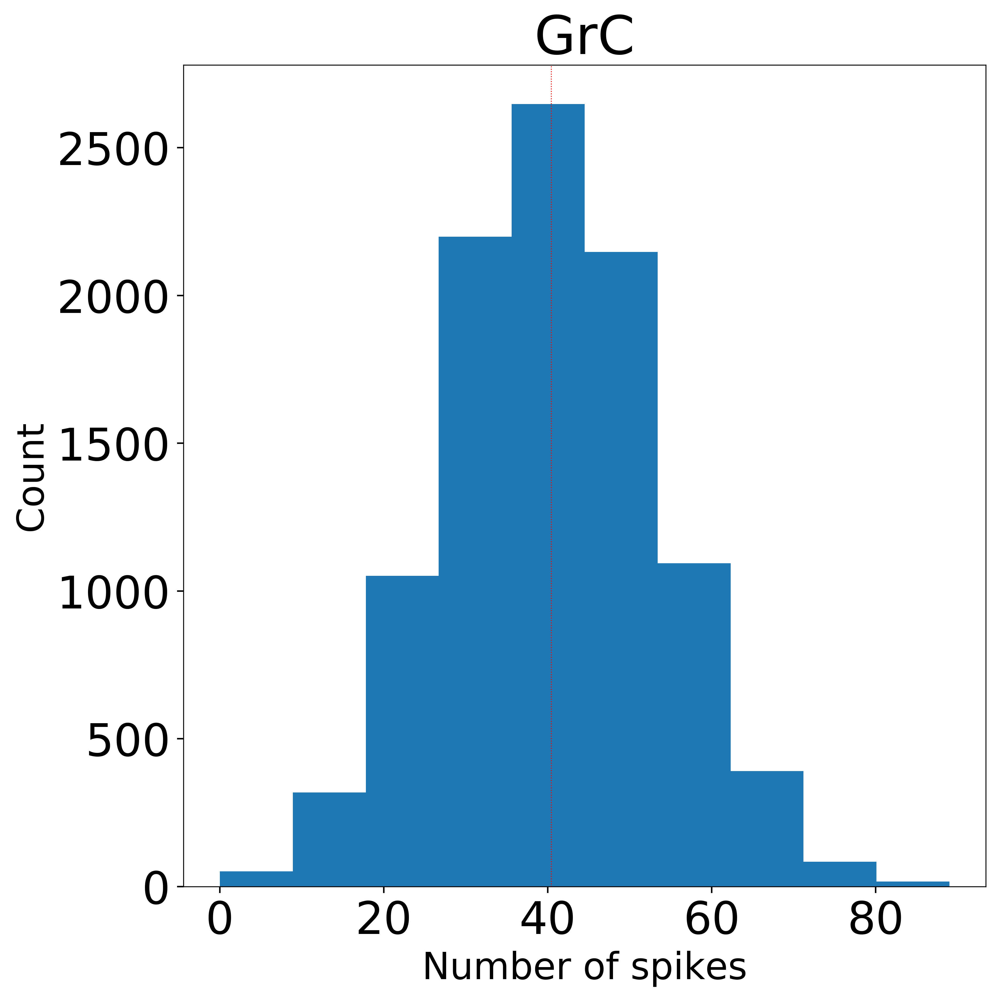

Plotting                                :figures/active_neurons_per_pop_golgi.png


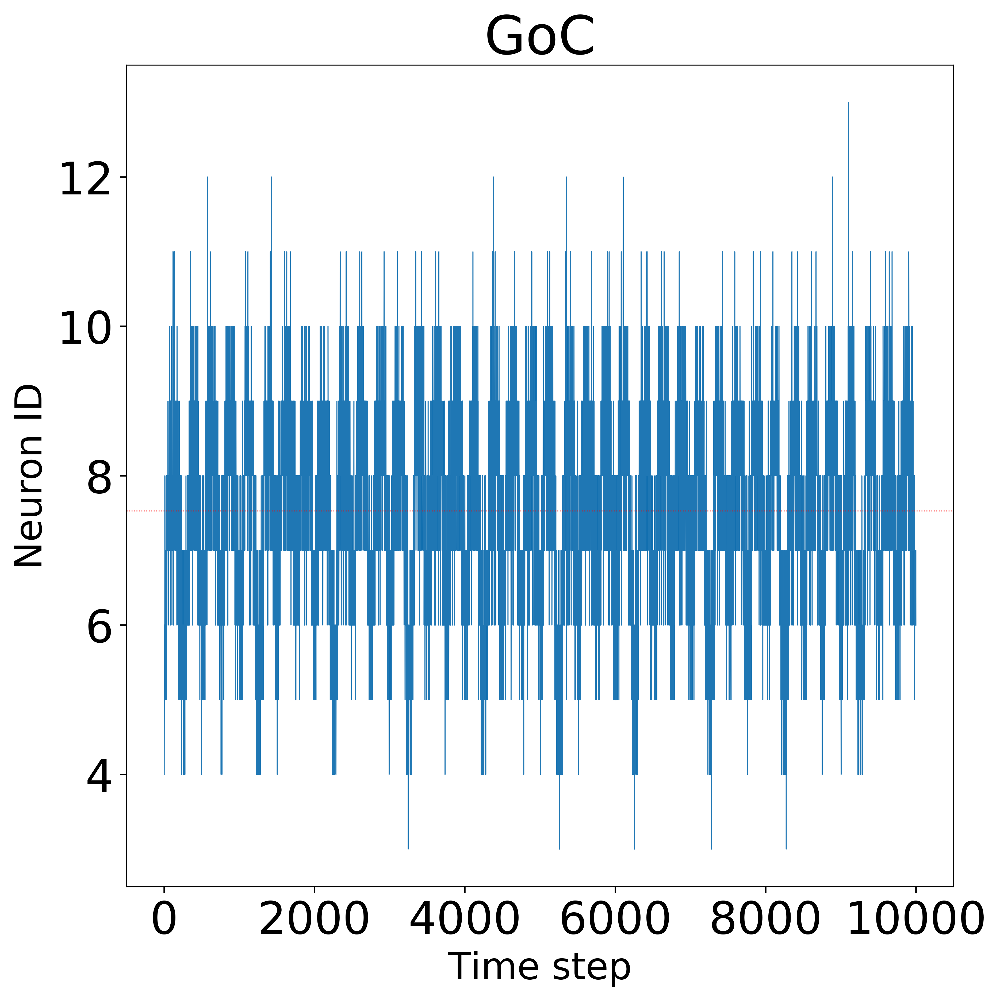

Plotting                                :figures/hist_active_neurons_per_pop_golgi.png


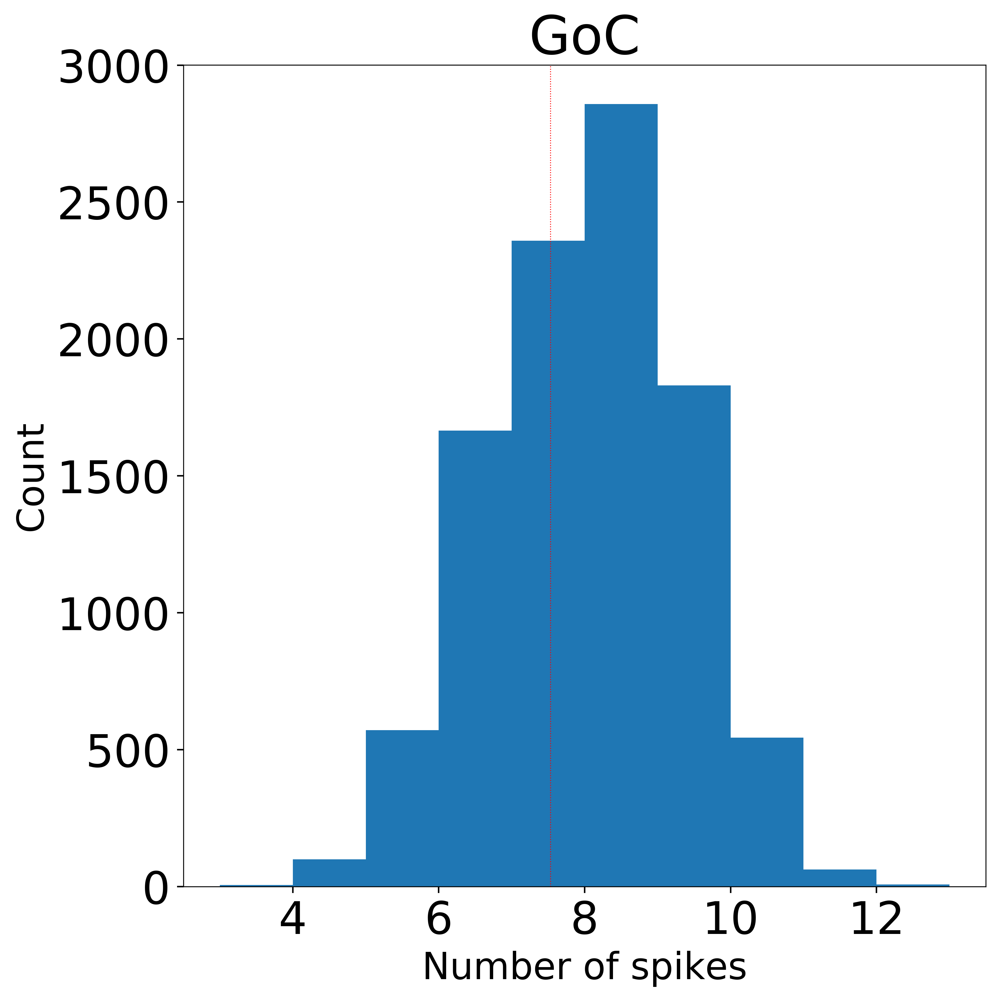

Plotting                                :figures/active_neurons_per_pop_purkinje.png


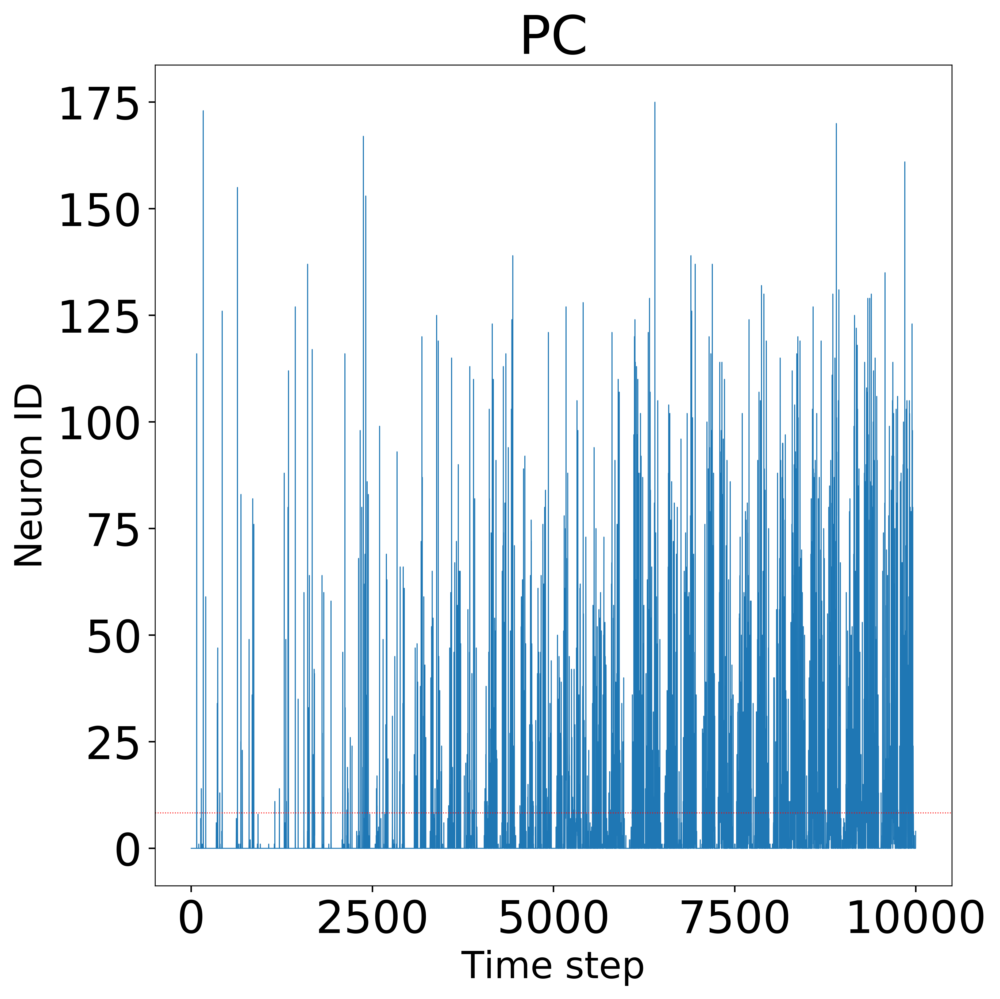

Plotting                                :figures/hist_active_neurons_per_pop_purkinje.png


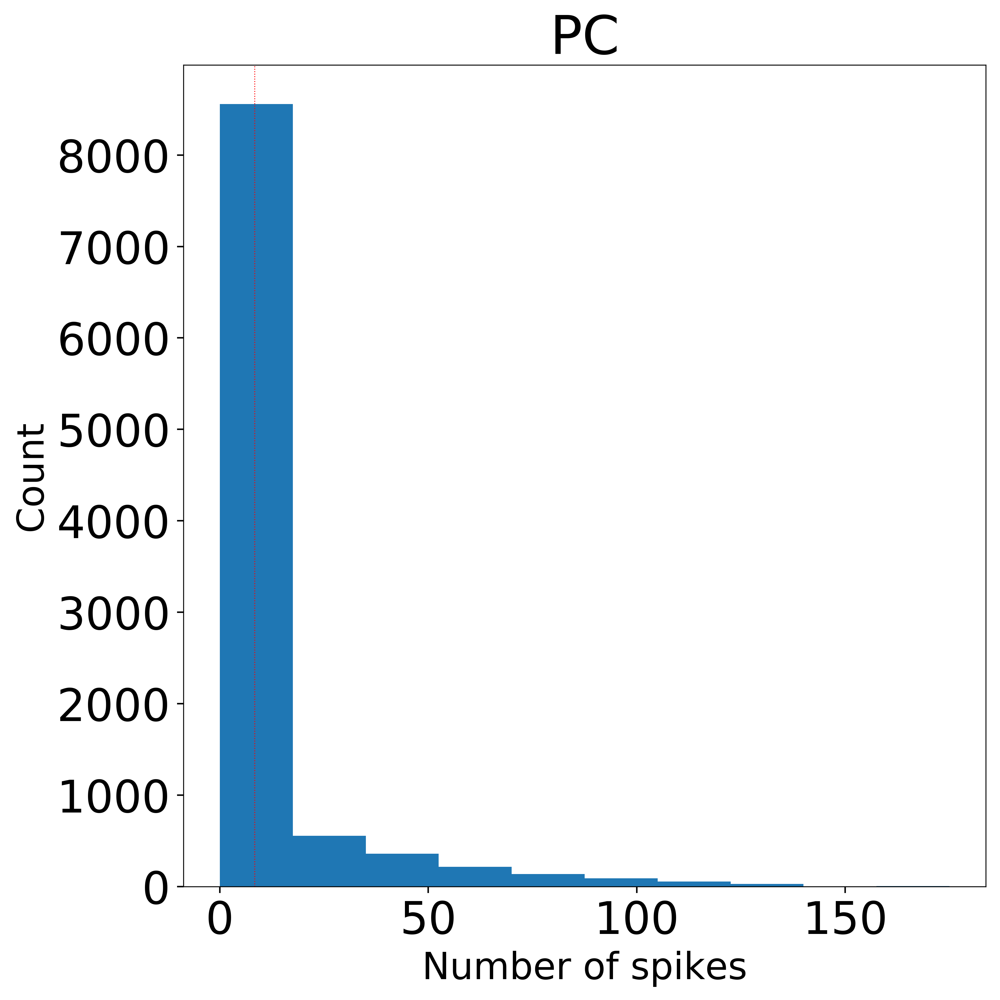

Plotting                                :figures/active_neurons_per_pop_climbing_fibres.png


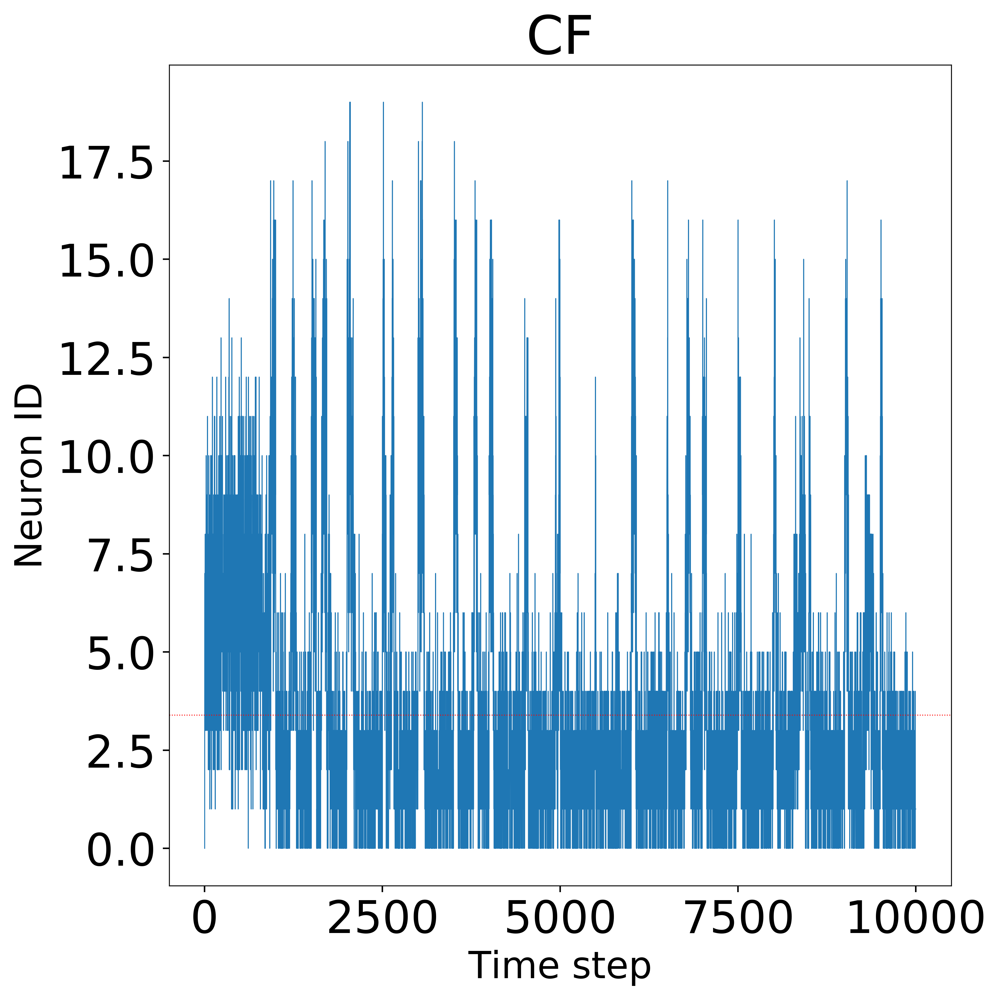

Plotting                                :figures/hist_active_neurons_per_pop_climbing_fibres.png


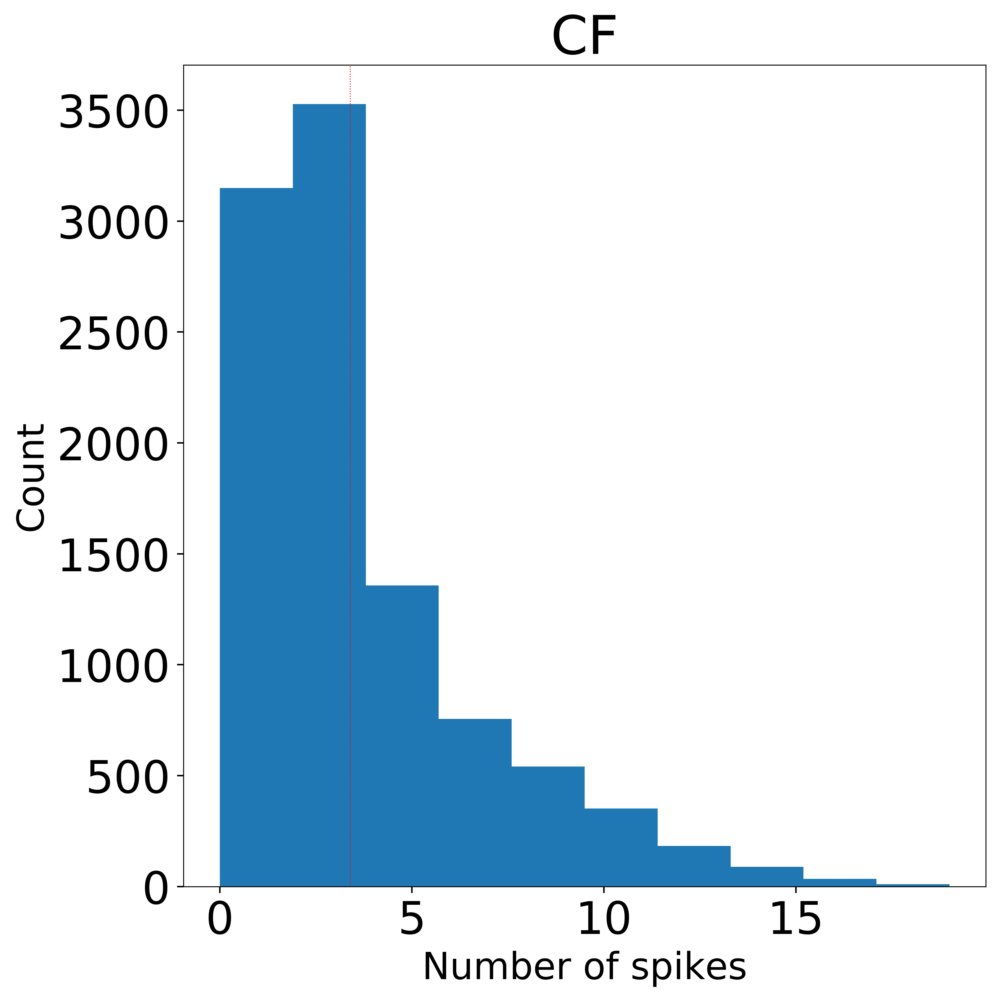

Plotting                                :figures/active_neurons_per_pop_vn.png  


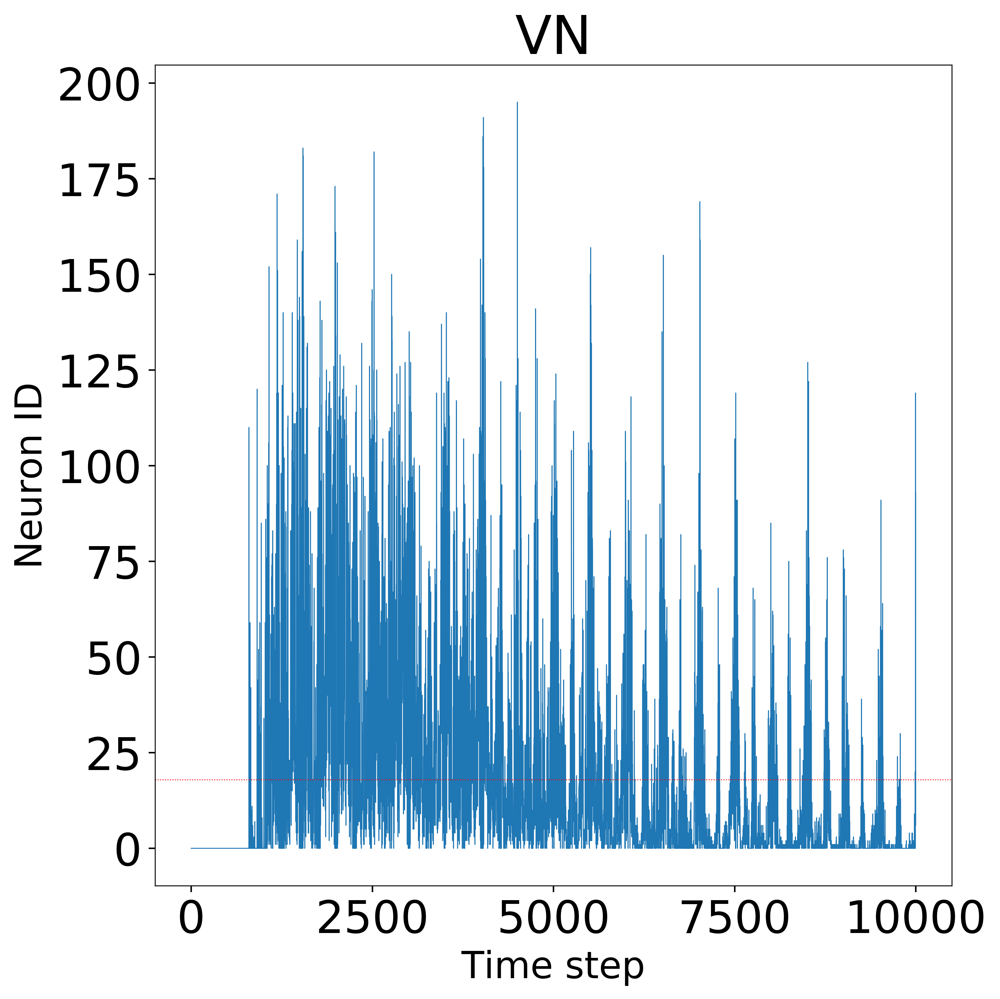

Plotting                                :figures/hist_active_neurons_per_pop_vn.png


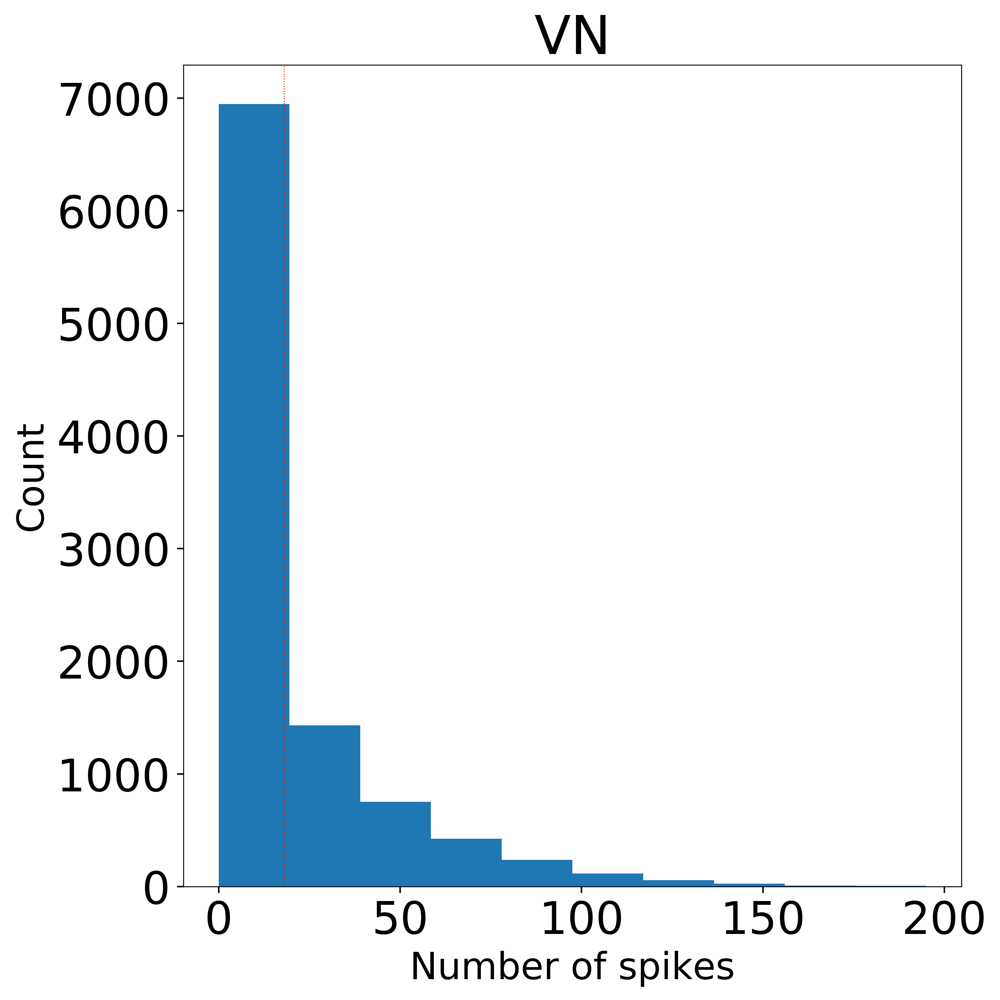

In [591]:
# How many cells are active each window?
for pop in plot_order:
    spikes_times_for_pop = all_spikes[pop][:, 1]
    nids_for_pop = all_spikes[pop][:, 0]
    pop_firing_rate_avg = np.empty(simtime // error_window_size)
    for window in range(simtime // error_window_size):
        w_start = window * error_window_size
        w_end = (window + 1) * error_window_size 
        spikes_in_window = np.logical_and(
                spikes_times_for_pop >= w_start,
                spikes_times_for_pop < w_end)
        spikes_produced_by_pop = np.count_nonzero(np.unique(nids_for_pop[spikes_in_window]))
        pop_firing_rate_avg[window] = spikes_produced_by_pop
        
    # Plotting 
    f = plt.figure(1, figsize=(8, 8), dpi=500)
    plt.plot(pop_firing_rate_avg)
    plt.axhline(np.mean(pop_firing_rate_avg), color="r", ls=":")

    plt.xlabel("Time step")
    plt.ylabel("Neuron ID")
    plt.title(use_display_name(pop))

    save_figure(plt, os.path.join('figures/',
                                  "active_neurons_per_pop_{}".format(pop)),
                #                         extensions=['.png', '.pdf'])
                extensions=['.png', ])
    plt.show()
    plt.close(f)
    # Hist plot
    f = plt.figure(1, figsize=(8, 8), dpi=500)
    plt.hist(pop_firing_rate_avg)
    plt.axvline(np.mean(pop_firing_rate_avg), color="r", ls=":")

    plt.xlabel("Number of spikes")
    plt.ylabel("Count")
    plt.title(use_display_name(pop))

    save_figure(plt, os.path.join('figures/',
                                  "hist_active_neurons_per_pop_{}".format(pop)),
                #                         extensions=['.png', '.pdf'])
                extensions=['.png', ])
    plt.show()
    plt.close(f)

In [592]:
2 * Hz * 10 * ms

0.02

In [593]:
30/0.02

1500.0

In [594]:
# compute maximum firing rate per window
error_window_size / (error_window_size * ms)

1. * khertz

In [595]:
# TODO look at the weights for pf-PC for each half neurons

# Network performance

In [596]:
stim_wanted_times = np.array([0, simtime])

Plotting                                :figures/number_of_packets_per_core_granule.png


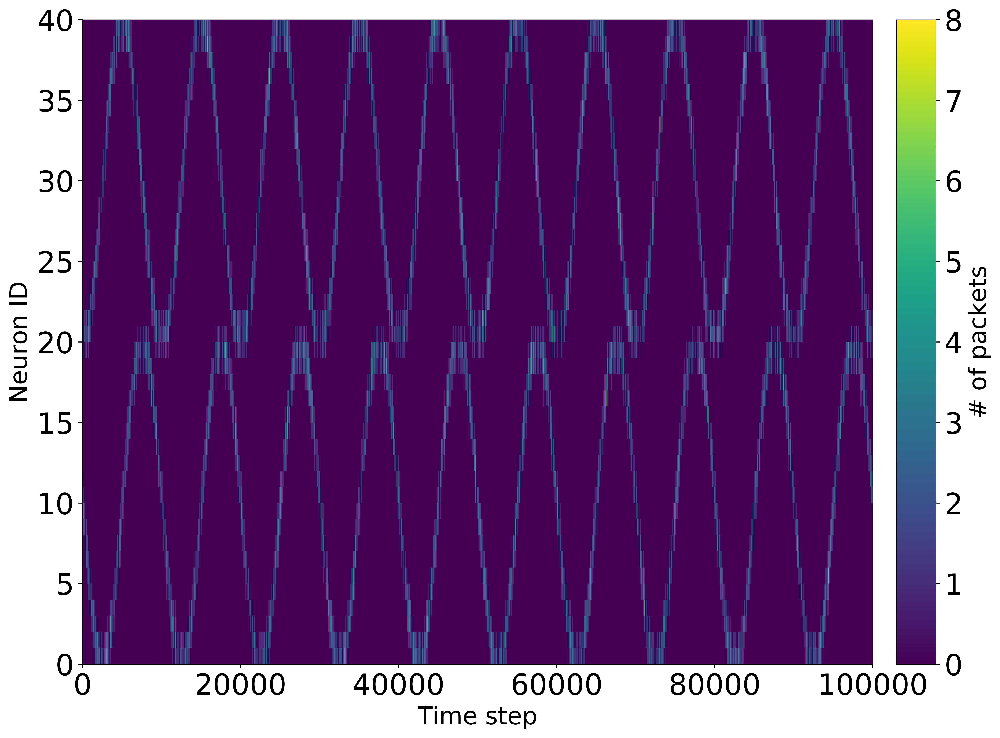

Plotting                                :figures/number_of_packets_per_core_golgi.png


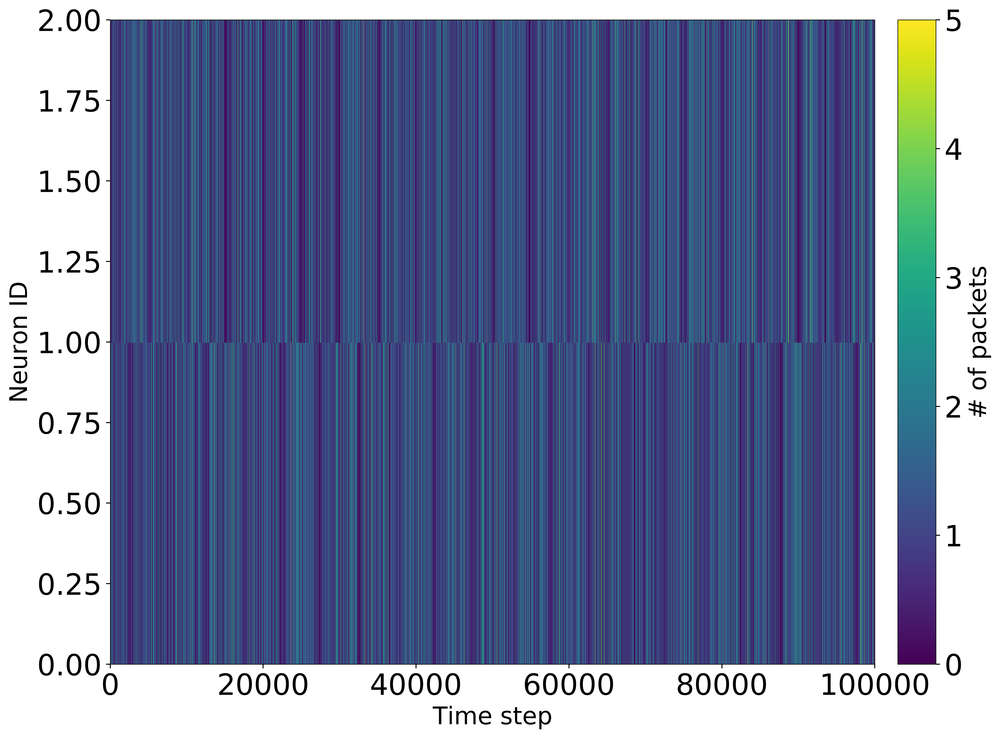

Plotting                                :figures/number_of_packets_per_core_purkinje.png


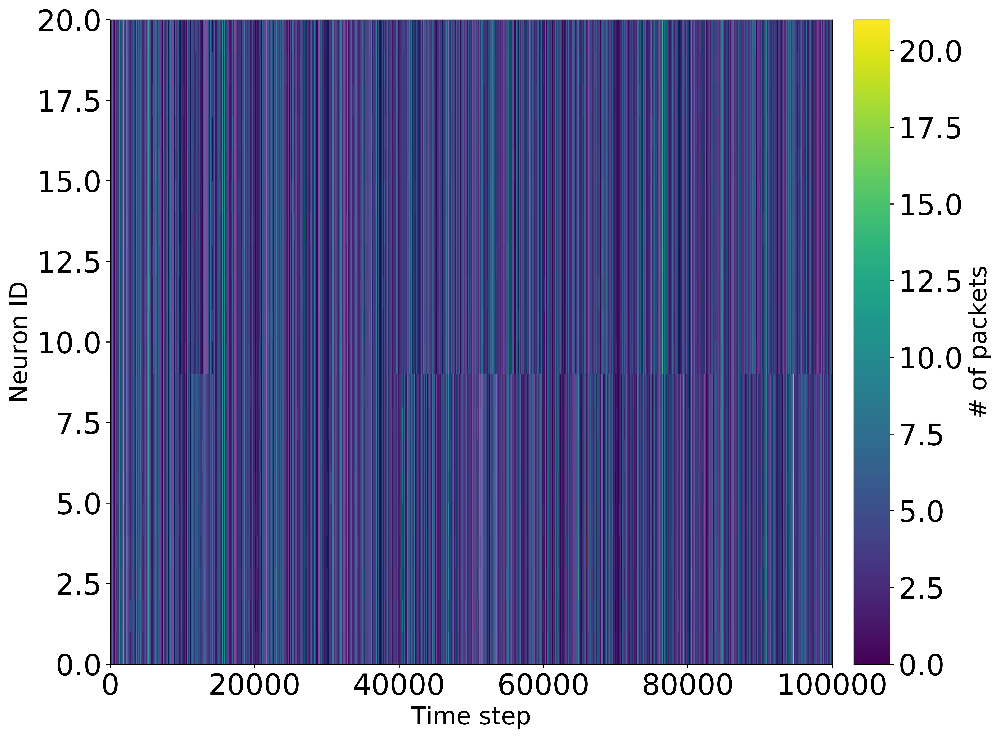

Plotting                                :figures/number_of_packets_per_core_vn.png


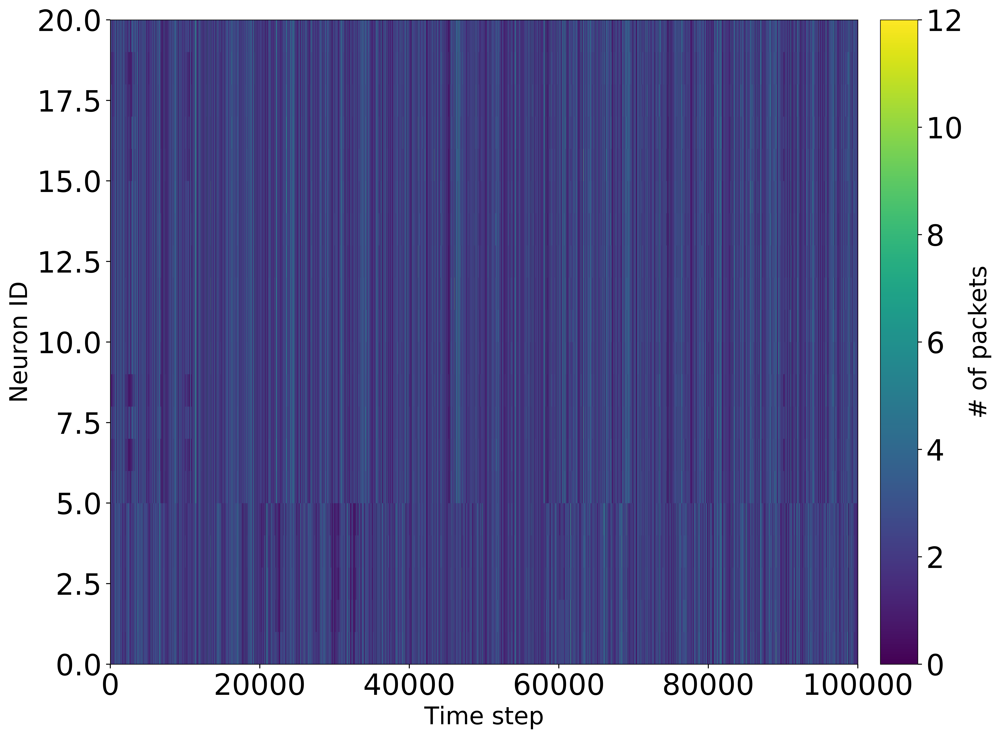

In [597]:
for pop in plot_order:
    if pop in other_recordings.keys():
        f = plt.figure(1, figsize=(12, 9), dpi=500)
        packets_per_ts = other_recordings[pop]['packets']
        im = plt.imshow(packets_per_ts,
                        interpolation='none',
                        extent=[stim_wanted_times.min() * time_to_bin_conversion,
                                stim_wanted_times.max() * time_to_bin_conversion,
                                0, packets_per_ts.shape[0]],
                        origin='lower')
        ax = plt.gca()
        ax.set_aspect('auto')
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", "5%", pad="3%")
        cbar = plt.colorbar(im, cax=cax)
        cbar.set_label("# of packets")

        ax.set_xlabel("Time step")
        ax.set_ylabel("Neuron ID")

        save_figure(plt, os.path.join('figures/',
                                      "number_of_packets_per_core_{}".format(pop)),
                    #                         extensions=['.png', '.pdf'])
                    extensions=['.png', ])
        plt.show()
        plt.close(f)

granule : 7
Plotting                                :figures/max_number_of_packets_per_core_granule.png


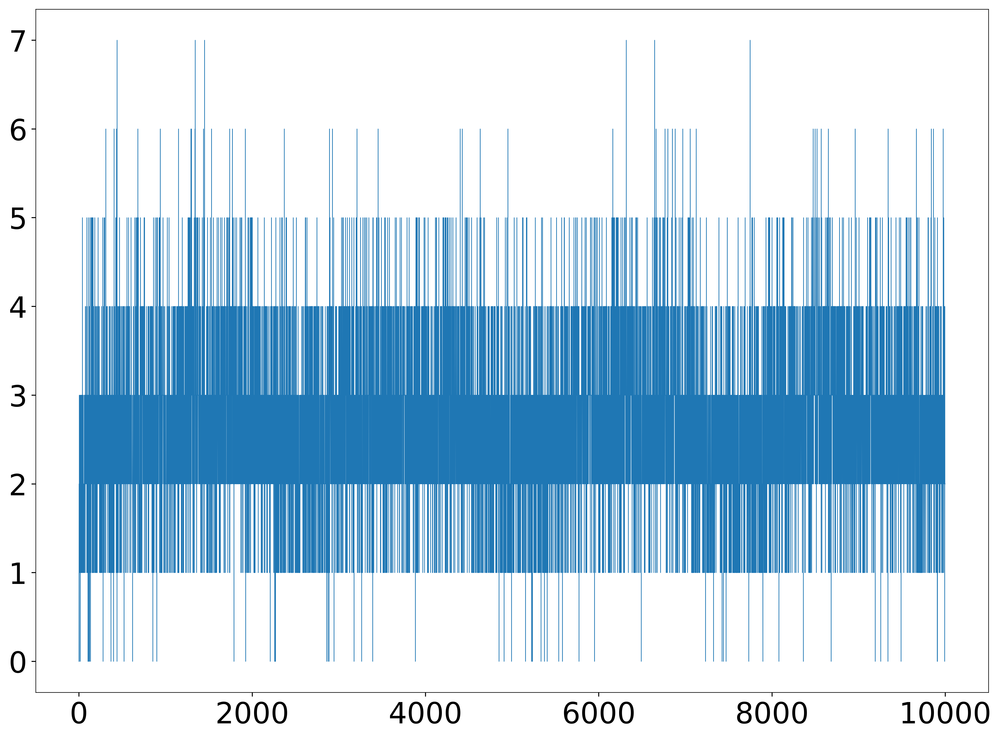

golgi : 5
Plotting                                :figures/max_number_of_packets_per_core_golgi.png


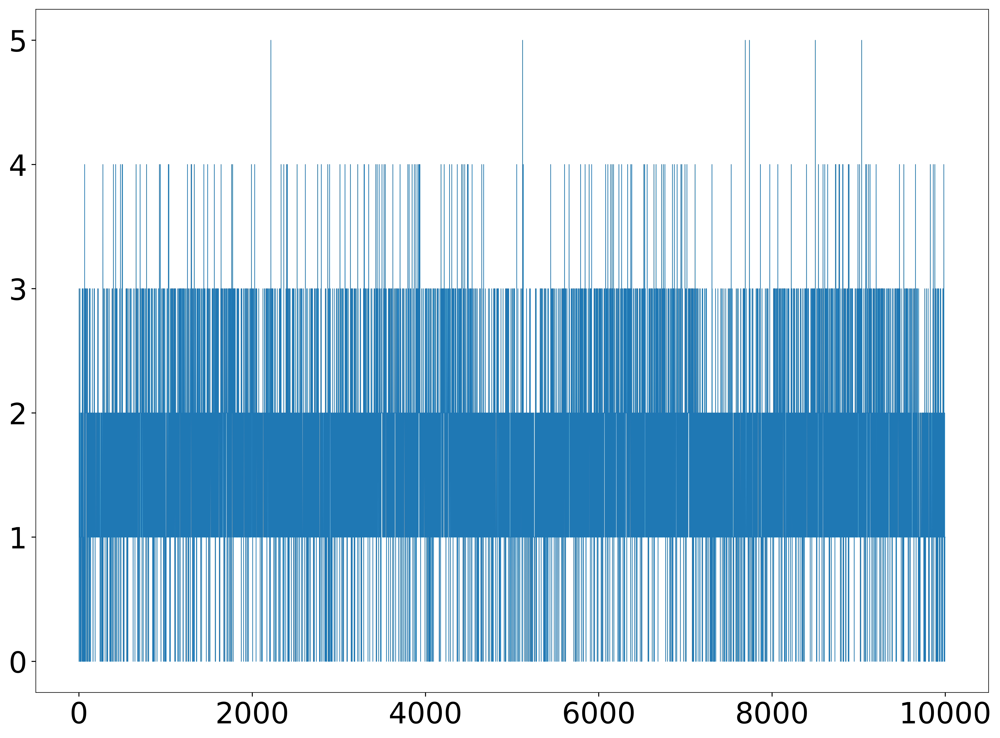

purkinje : 20
Plotting                                :figures/max_number_of_packets_per_core_purkinje.png


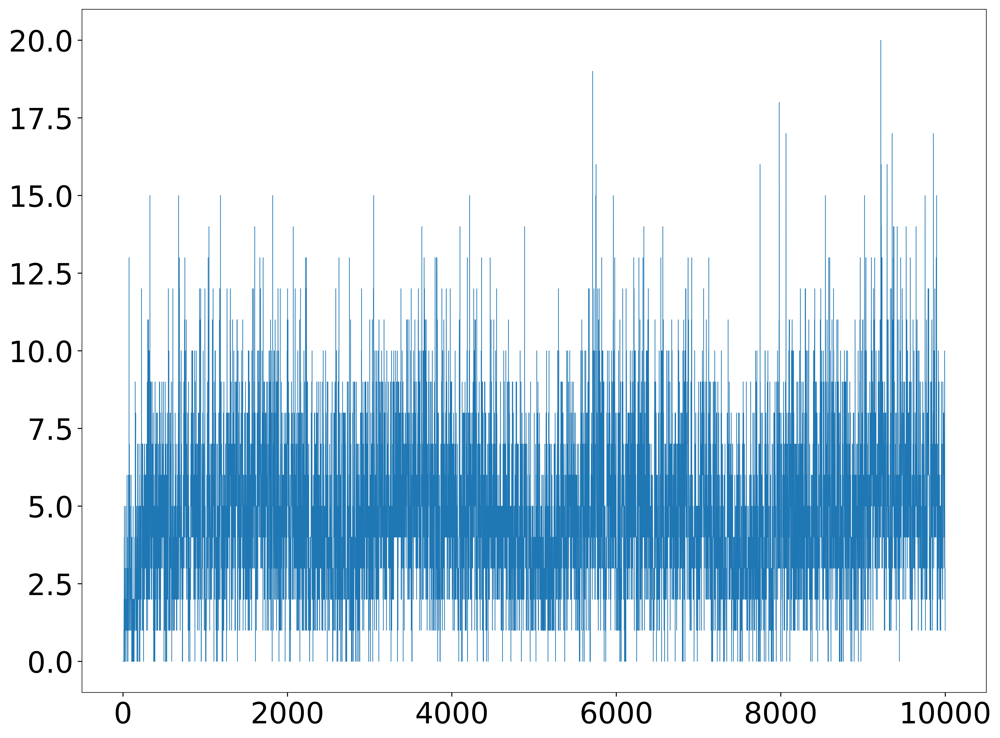

vn : 12
Plotting                                :figures/max_number_of_packets_per_core_vn.png


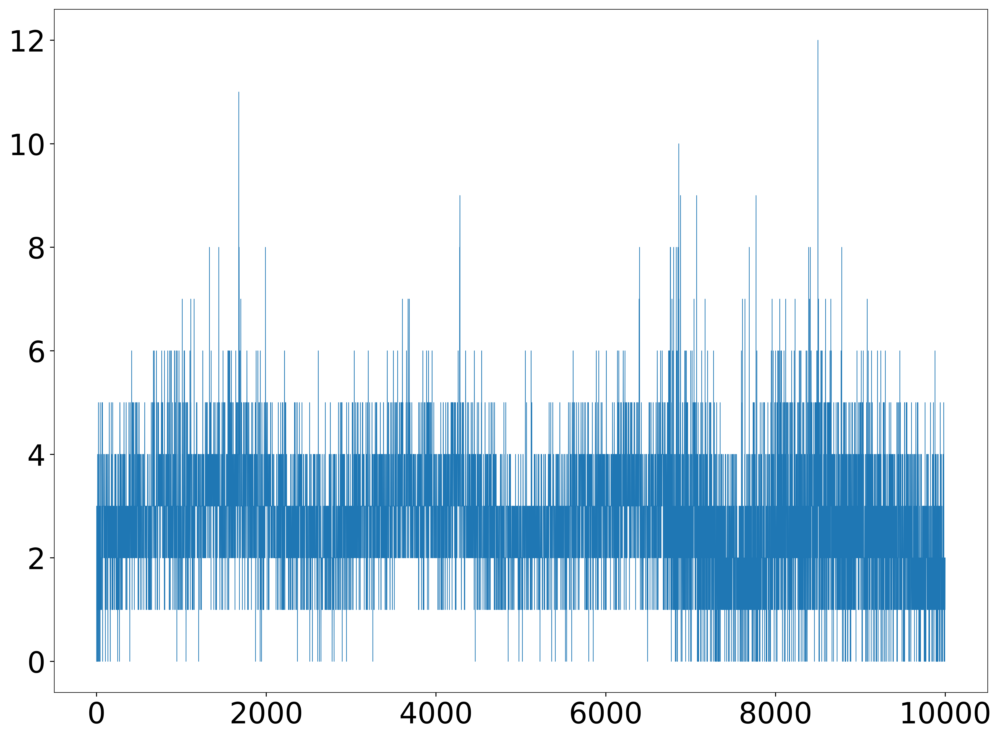

In [598]:
max_packets = {}
for pop in plot_order:
    if pop in other_recordings.keys():
        f = plt.figure(1, figsize=(12, 9), dpi=500)
        packets_per_ts = other_recordings[pop]['packets']
        max_packets_per_ts = np.max(packets_per_ts, axis=0)[:10000]
        print(pop, ":", np.max(max_packets_per_ts))
        max_packets[pop] = np.max(max_packets_per_ts)
        plt.plot(max_packets_per_ts)

        ax.set_xlabel("Time step")
        ax.set_ylabel("Neuron ID")

        save_figure(plt, os.path.join('figures/',
                                      "max_number_of_packets_per_core_{}".format(pop)),
                    #                         extensions=['.png', '.pdf'])
                    extensions=['.png', ])
        plt.show()
        plt.close(f)

In [599]:
max_packets

{'golgi': 5, 'granule': 7, 'purkinje': 20, 'vn': 12}

In [600]:
max_packets

{'golgi': 5, 'granule': 7, 'purkinje': 20, 'vn': 12}

# Look at the evolution of the connectivity in the network

Is PC-VN correct?

In [601]:
final_connectivity.keys()

dict_keys(['mf_grc', 'pf_pc', 'mf_goc', 'pc_vn', 'goc_grc_1', 'pc_vn_teaching', 'goc_grc_2', 'mf_vn', 'cf_pc'])

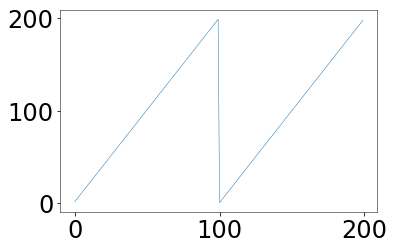

In [602]:
plt.plot(final_connectivity['pc_vn'][-1][:, 0], final_connectivity['pc_vn'][-1][:, 1])

In [603]:
final_connectivity['pc_vn'][-1][:, 1]

array([  1.,   3.,   5.,   7.,   9.,  11.,  13.,  15.,  17.,  19.,  21.,
        23.,  25.,  27.,  29.,  31.,  33.,  35.,  37.,  39.,  41.,  43.,
        45.,  47.,  49.,  51.,  53.,  55.,  57.,  59.,  61.,  63.,  65.,
        67.,  69.,  71.,  73.,  75.,  77.,  79.,  81.,  83.,  85.,  87.,
        89.,  91.,  93.,  95.,  97.,  99., 101., 103., 105., 107., 109.,
       111., 113., 115., 117., 119., 121., 123., 125., 127., 129., 131.,
       133., 135., 137., 139., 141., 143., 145., 147., 149., 151., 153.,
       155., 157., 159., 161., 163., 165., 167., 169., 171., 173., 175.,
       177., 179., 181., 183., 185., 187., 189., 191., 193., 195., 197.,
       199.,   0.,   2.,   4.,   6.,   8.,  10.,  12.,  14.,  16.,  18.,
        20.,  22.,  24.,  26.,  28.,  30.,  32.,  34.,  36.,  38.,  40.,
        42.,  44.,  46.,  48.,  50.,  52.,  54.,  56.,  58.,  60.,  62.,
        64.,  66.,  68.,  70.,  72.,  74.,  76.,  78.,  80.,  82.,  84.,
        86.,  88.,  90.,  92.,  94.,  96.,  98., 10

In [604]:
2**(-15 + 6) / (2**10)

1.9073486328125e-06

In [605]:
# Larget weight representable with 16 bits and a shift of 6
2**(6+1) - 1

127

In [606]:
import math

In [607]:
def round_to_nearest_accum(x, shift):
    eps = 2. ** (-15 + shift)
    x_approx = np.floor((x / eps) + 0.5) * eps
    return x_approx

# Provenance analysis

In [755]:

def extract_per_pop_placements(df, pops):
    placement_results = {}
    for pop in pops:
        pop_df = df[df['pop'] == pop]
        placement_df = pop_df[["x", "y", "p", "no_atoms"]].drop_duplicates()
        placement_results[pop] = placement_df
    return placement_results


def extract_per_pop_info(df, type_of_prov, pops, report=False):
    pop_results = {k: None for k in pops}
    pop_results['global_mean'] = np.nan
    pop_results['global_max'] = np.nan
    pop_results['global_min'] = np.nan

    prov_filter = df['prov_name'] == type_of_prov
    filtered_prov = df[prov_filter]
    if report:
        print("{:40} for populations:".format(type_of_prov))

    _means = []
    _maxs = []
    _mins = []
    for pop in pops:
        pop_df = filtered_prov[filtered_prov['pop'] == pop]
        curr_pop_values = pop_df.prov_value
        _mean = curr_pop_values.mean()
        _max = curr_pop_values.max()
        _min = curr_pop_values.min()
        if report:
            print("\t{:25} - avg {:10.2f} max {:10.2f}".format(
                pop, curr_pop_values.mean(), curr_pop_values.max()))
        # save values
        pop_results[pop] = {
            'mean': _mean,
            'max': _max,
            'min': _min,
            'all': curr_pop_values
        }
        _means.append(_mean)
        _maxs.append(_max)
        _mins.append(_min)
    if report:
        write_line()
    pop_results['global_mean'] = np.nanmean(np.asarray(_means))
    pop_results['global_max'] = np.nanmax(np.asarray(_maxs))
    pop_results['global_min'] = np.nanmin(np.asarray(_mins))
    return pop_results


def provenance_csv_analysis(in_folder, fig_folder):
    write_header("Reading provenances in folder " + in_folder)
    prov = pd.read_csv(join(in_folder, "structured_provenance.csv"))
    pops = prov['pop'].unique()
    pops.sort()
    types_of_provenance = prov['prov_name'].unique()
    prov_of_interest = [
        'MAX_SPIKES_IN_A_TICK',
        'Times_synaptic_weights_have_saturated',
        'late_packets',
        'Times_the_input_buffer_lost_packets',
        'Times_the_timer_tic_over_ran',
        'Total_pre_synaptic_events',
        'MAX_DMAS_IN_A_TICK',
        'MAX_PIPELINE_RESTARTS',
        'send_multicast_packets',
        'MAX_FLUSHED_SPIKES',
        'TOTAL_FLUSHED_SPIKES'
    ]

    results = {k: None for k in types_of_provenance}
    # TODO report number of neurons to make sure the networks is correct
    write_short_msg("DETECTED POPULATIONS", pops)

    for type_of_prov in types_of_provenance:
        rep = True if type_of_prov in prov_of_interest else False
        results[type_of_prov] = extract_per_pop_info(prov, type_of_prov, pops,
                                                     report=rep)
    placements = extract_per_pop_placements(prov, pops)
    return results, types_of_provenance, prov_of_interest, placements


def sweep_provenance_analysis(in_folder, fig_folder, group_on,
                              group_on_name):
    # Check if the folders exist
    if not os.path.isdir(fig_folder) and not os.path.exists(fig_folder):
        os.mkdir(fig_folder)
    current_fig_folder = join(fig_folder, in_folder.split('/')[-1])
    # Make folder for current figures
    if not os.path.isdir(current_fig_folder) and not os.path.exists(current_fig_folder):
        os.mkdir(current_fig_folder)

    write_header("Analysing provenances in folder " + in_folder)
    folder_contents = os.listdir(in_folder)
    batch_infos = [fc for fc in folder_contents if "batch_" in fc]
    if len(batch_infos) > 1:
        raise FileExistsError("There are multiple batch info .npz archives "
                              "in the current directory!")
    if len(batch_infos) == 1:
        batch_info = np.load(join(in_folder, batch_infos[0]), allow_pickle=True)
        run_id = "@" + batch_infos[0].split("_")[1].split(".")[0]
        if batch_info:
            write_header("Batch info contained in " + batch_infos[0])
            write_short_msg("FILES", batch_info.files)
            poi = batch_info['parameters_of_interest'].ravel()[0]
            calls = batch_info['log_calls']
            write_short_msg("PARAMETERS", poi)
        run_folders = [fc for fc in folder_contents if run_id in fc]

    if len(batch_infos) == 0:
        print("No batch info detected. Going to assume that "
              "all folders in the current directory are "
              "related to the run.")
        calls, poi = None
        run_folders = [fc for fc in folder_contents if os.path.isdir(join(in_folder, fc))]
    collated_results = {k: None for k in run_folders}
    types_of_provenance = None
    prov_of_interest = None
    placements = {}

    router_provenance_of_interest = [
        'Dumped_from_a_Link',
        'Dumped_from_a_processor',
        'Local_Multicast_Packets',
        'External_Multicast_Packets',
        'Dropped_Multicast_Packets',
        'Missed_For_Reinjection'
    ]
    router_pop_names = ['router_provenance']

    write_short_msg("Number of folders", len(run_folders))
    write_sep()
    for folder in run_folders:
        collated_results[folder], types_of_provenance, \
        prov_of_interest, placements[folder] = provenance_csv_analysis(
            join(in_folder, folder), fig_folder)

    if group_on_name is None:
        write_header("REPORTING BEST SIMULATIONS")
        cumulative_report(collated_results, types_of_provenance,
                          prov_of_interest)
    else:
        for condition in group_on_name:
            write_header("GROUPING ON CONDITION {}".format(condition))
            new_collated_results = {key: value for (key, value) in
                                    collated_results.items() if condition in key}
            cumulative_report(new_collated_results, types_of_provenance,
                              prov_of_interest)

    plot_per_population_provenance_of_interest(
        collated_results, calls, poi, router_provenance_of_interest,
        group_on or group_on_name, current_fig_folder,
        router_pop=router_pop_names)

    plot_population_placement(collated_results, placements,
                              fig_folder=current_fig_folder)

    for folder in run_folders:
        plot_router_provenance(in_folder, folder, router_pop_names,
                               router_provenance_of_interest,
                               current_fig_folder)

    plot_per_population_provenance_of_interest(collated_results, calls, poi,
                                               prov_of_interest,
                                               group_on or group_on_name,
                                               current_fig_folder)

    for folder in run_folders:
        plot_2D_map_for_poi(in_folder, folder,
                            prov_of_interest, router_pop_names,
                            current_fig_folder, placements)


def plot_2D_map_for_poi(folder, selected_sim,
                        provenance_of_interest, router_pop_names, fig_folder, placements):
    write_header("PLOTTING MAPS FOR ALL PRROVENANCE OF INTEREST")
    prov = pd.read_csv(join(join(folder, selected_sim), "structured_provenance.csv"))
    # Filter out router provenance because the logic for plotting those maps is slightly different
    pop_only_prov = prov[~prov['pop'].isin(router_pop_names)]
    filtered_placement = \
        placements[selected_sim]
    try:
        router_provenance = filtered_placement['router_provenance']
    except KeyError:
        traceback.print_exc()
        router_provenance = filtered_placement

    for type_of_provenance in provenance_of_interest:
        #  need to get processor p as well as x y prov_value
        filtered_placement = \
            pop_only_prov[pop_only_prov.prov_name == type_of_provenance][['x', 'y', 'p', 'prov_value']]
        if filtered_placement.shape[0] == 0:
            write_short_msg("NO INFORMATION FOR PROVENANCE", type_of_provenance)
            continue

        # make a new directory for each provenance
        # Check if the results folder exist
        per_prov_dir = os.path.join(fig_folder, type_of_provenance.lower())
        if not os.path.isdir(per_prov_dir) and not os.path.exists(per_prov_dir):
            os.mkdir(per_prov_dir)
        # Plotting bit
        # Fake printing to start things off...
        f = plt.figure(1, figsize=(9, 9), dpi=400)
        plt.close(f)
        # Compute plot order
        plot_order = get_plot_order(router_pop_names)
        plot_display_names = []
        for po in plot_order:
            plot_display_names.append(use_display_name(po))

        magic_constant = 4
        max_x = (router_provenance.x.max() + 1) * magic_constant
        max_y = (router_provenance.y.max() + 1) * magic_constant

        x_ticks = np.arange(0, max_x, magic_constant)[::2]
        x_tick_lables = (x_ticks / magic_constant).astype(int)
        y_ticks = np.arange(0, max_y, magic_constant)[::2]
        y_tick_lables = (y_ticks / magic_constant).astype(int)
        map = np.ones((max_x, max_y)) * np.nan

        for row_index, row in filtered_placement.iterrows():
            x_pos = int(magic_constant * row.x +
                        ((row.p // magic_constant) % magic_constant))
            y_pos = int(magic_constant * row.y +
                        (row.p % magic_constant))
            map[x_pos, y_pos] = row.prov_value

        # crop_point = np.max(np.max(np.argwhere(np.isfinite(map)), axis=0))
        f = plt.figure(1, figsize=(9, 9), dpi=500)
        # plt.matshow(map[:crop_point, :crop_point], interpolation='none')
        im = plt.imshow(map, interpolation='none',
                        cmap=plt.get_cmap('inferno'),
                        extent=[0, max_x, 0, max_y],
                        origin='lower')
        ax = plt.gca()

        plt.xlabel("Chip X coordinate")
        plt.ylabel("Chip Y coordinate")

        plt.xticks(x_ticks, x_tick_lables)
        plt.yticks(y_ticks, y_tick_lables)
        ax.yaxis.set_minor_locator(MultipleLocator(magic_constant))
        ax.xaxis.set_minor_locator(MultipleLocator(magic_constant))

        plt.grid(b=True, which='both', color='k', linestyle='-')

        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", "5%", pad="3%")
        cbar = plt.colorbar(im, cax=cax)
        cbar.set_label(use_display_name(type_of_provenance))

        save_figure(plt, join(per_prov_dir,
                              "map_of_{}_for_{}".format(type_of_provenance,
                                                        selected_sim)),
                    extensions=['.png', '.pdf'])
        plt.close(f)


def plot_router_provenance(folder, selected_sim, router_pop_names,
                           router_provenance_of_interest, fig_folder):
    write_header("PLOTTING ROUTER INFO AND MAPS")
    prov = pd.read_csv(join(join(folder, selected_sim), "structured_provenance.csv"))
    # Need to filter only info for routers
    # then filter by type of router provenance
    # extract X, Y, prov_value
    # Plot map
    router_only_prov = prov[prov['pop'].isin(router_pop_names)]

    for type_of_provenance in router_provenance_of_interest:
        filtered_placement = \
            router_only_prov[router_only_prov.prov_name == type_of_provenance][['x', 'y', 'prov_value']]
        if filtered_placement.shape[0] == 0:
            write_short_msg("NO INFORMATION FOR PROVENANCE", type_of_provenance)
            continue

        # make a new directory for each provenance
        # Check if the results folder exist
        per_prov_dir = os.path.join(fig_folder, type_of_provenance.lower())
        if not os.path.isdir(per_prov_dir) and not os.path.exists(per_prov_dir):
            os.mkdir(per_prov_dir)
        # Plotting bit
        # Fake printing to start things off...
        f = plt.figure(1, figsize=(9, 9), dpi=400)
        plt.close(f)
        # Compute plot order
        plot_order = get_plot_order(router_pop_names)
        plot_display_names = []
        for po in plot_order:
            plot_display_names.append(use_display_name(po))

        magic_constant = 4
        max_x = (filtered_placement.x.max() + 1) * magic_constant
        max_y = (filtered_placement.y.max() + 1) * magic_constant
        x_ticks = np.arange(0, max_x, magic_constant)[::2]
        # x_tick_lables = np.linspace(0, collated_placements.x.max(), 6).astype(int)
        x_tick_lables = (x_ticks / magic_constant).astype(int)
        y_ticks = np.arange(0, max_y, magic_constant)[::2]
        # y_tick_lables = np.linspace(0, collated_placements.y.max(), 6).astype(int)
        y_tick_lables = (y_ticks / magic_constant).astype(int)
        map = np.ones((max_x, max_y)) * np.nan

        for row_index, row in filtered_placement.iterrows():
            map[
            int(magic_constant * row.x):int(magic_constant * (row.x + 1)),
            int(magic_constant * row.y):int(magic_constant * (row.y + 1))
            ] = row.prov_value

        # crop_point = np.max(np.max(np.argwhere(np.isfinite(map)), axis=0))
        f = plt.figure(1, figsize=(9, 9), dpi=500)
        # plt.matshow(map[:crop_point, :crop_point], interpolation='none')
        im = plt.imshow(map, interpolation='none',
                        cmap=plt.get_cmap('inferno'),
                        extent=[0, max_x, 0, max_y],
                        origin='lower')
        ax = plt.gca()

        plt.xlabel("Chip X coordinate")
        plt.ylabel("Chip Y coordinate")

        plt.xticks(x_ticks, x_tick_lables)
        plt.yticks(y_ticks, y_tick_lables)
        ax.yaxis.set_minor_locator(MultipleLocator(magic_constant))
        ax.xaxis.set_minor_locator(MultipleLocator(magic_constant))

        plt.grid(b=True, which='both', color='k', linestyle='-')

        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", "5%", pad="3%")
        cbar = plt.colorbar(im, cax=cax)
        cbar.set_label(use_display_name(type_of_provenance))

        save_figure(plt, join(per_prov_dir,
                              "map_of_{}_for_{}".format(type_of_provenance,
                                                        selected_sim)),
                    extensions=['.png', '.pdf'])
        plt.close(f)


def cumulative_report(collated_results, types_of_provenance, prov_of_interest):
    sorted_key_list = list(collated_results.keys())
    sorted_key_list.sort()
    for type_of_prov in types_of_provenance:
        of_interest = True if type_of_prov in prov_of_interest else False
        if not of_interest:
            continue
        # Need to loop over all dicts in collated_results
        _means = []
        _maxs = []
        _mins = []
        _keys = []
        _max_values_per_pop = None

        print("{:40} for all cases".format(type_of_prov))
        for k in sorted_key_list:
            v = collated_results[k]
            filtered_v = v[type_of_prov]
            _keys.append(k)
            _means.append(filtered_v['global_mean'])
            _maxs.append(filtered_v['global_max'])
            _mins.append(filtered_v['global_min'])
            print("{:40} | min {:10.2f} | mean {:10.2f} | max {:10.2f}".format(
                k.split("@")[0], filtered_v['global_min'], filtered_v['global_mean'], filtered_v['global_max']
            ))
            if _max_values_per_pop is None:
                _max_values_per_pop = {x: [] for x in filtered_v.keys() if "cell" in x}
            for vp in _max_values_per_pop.keys():
                _max_values_per_pop[vp].append(filtered_v[vp]['max'])
        # Report cumulative stats per population
        write_line()
        print("{:40} for all populations".format(type_of_prov))
        reporting_keys = list(_max_values_per_pop.keys())
        reporting_keys.sort()
        for rk in reporting_keys:
            vals = _max_values_per_pop[rk]
            print("{:40} | mean {:10.2f} | max {:10.2f} | std {:10.2f}".format(
                rk, np.nanmean(vals), np.nanmax(vals), np.nanstd(vals)
            ))


def plot_population_placement(collated_results, placements, fig_folder):
    write_header("PLOTTING MAPS")
    sorted_key_list = list(collated_results.keys())
    sorted_key_list.sort()
    for selected_sim in sorted_key_list:
        filtered_placement = \
            placements[selected_sim]
        # try:
        router_provenance = filtered_placement['router_provenance']
        # except KeyError:
        #     traceback.print_exc()
        #     continue

        placements_per_pop = {x: filtered_placement[x]
                              for x in filtered_placement.keys()
                              if "cell" in x}
        # make a new directory for each provenance
        # Check if the results folder exist
        per_prov_dir = os.path.join(fig_folder, "placements")
        if not os.path.isdir(per_prov_dir) and not os.path.exists(per_prov_dir):
            os.mkdir(per_prov_dir)

        # Plotting bit
        # Fake printing to start things off...
        f = plt.figure(1, figsize=(9, 9), dpi=400)
        plt.close(f)
        # Compute plot order
        plot_order = get_plot_order(placements_per_pop.keys())
        plot_display_names = []
        for po in plot_order:
            plot_display_names.append(use_display_name(po))
        n_plots = len(plot_order)

        collated_placements = pd.concat([
            filtered_placement[x] for x in plot_order
        ])

        magic_constant = 4

        max_x = (router_provenance.x.max() + 1) * magic_constant
        max_y = (router_provenance.y.max() + 1) * magic_constant

        x_ticks = np.arange(0, max_x, magic_constant)[::2]
        x_tick_lables = (x_ticks / magic_constant).astype(int)
        y_ticks = np.arange(0, max_y, magic_constant)[::2]
        y_tick_lables = (y_ticks / magic_constant).astype(int)
        map = np.ones((max_x, max_y)) * np.nan
        for index, pop in enumerate(plot_order):
            curr_pl = placements_per_pop[pop]
            for row_index, row in curr_pl.iterrows():
                x_pos = int(magic_constant * row.x +
                            ((row.p // magic_constant) % magic_constant))
                y_pos = int(magic_constant * row.y +
                            (row.p % magic_constant))
                map[x_pos, y_pos] = index

        uniques = np.unique(map[np.isfinite(map)]).astype(int)
        # crop_point = np.max(np.max(np.argwhere(np.isfinite(map)), axis=0))
        f = plt.figure(1, figsize=(9, 9), dpi=500)
        # plt.matshow(map[:crop_point, :crop_point], interpolation='none')
        im = plt.imshow(map, interpolation='none', vmin=0, vmax=n_plots,
                        cmap=plt.get_cmap('viridis', n_plots),
                        extent=[0, max_x, 0, max_y],
                        origin='lower')
        ax = plt.gca()

        plt.xlabel("Chip X coordinate")
        plt.ylabel("Chip Y coordinate")

        plt.xticks(x_ticks, x_tick_lables)
        plt.yticks(y_ticks, y_tick_lables)
        ax.yaxis.set_minor_locator(MultipleLocator(magic_constant))
        ax.xaxis.set_minor_locator(MultipleLocator(magic_constant))

        plt.grid(b=True, which='both', color='k', linestyle='-')

        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", "5%", pad="3%")
        cbar = plt.colorbar(im, cax=cax)
        cbar.set_label("Population")
        cbar.ax.set_yticks(uniques)
        cbar.ax.set_yticklabels(plot_display_names)

        save_figure(plt, join(per_prov_dir,
                              "map_of_placements_for_{}".format(selected_sim)),
                    extensions=['.png', '.pdf'])
        plt.close(f)

        # Some reports
        write_short_msg("Plotting map for", selected_sim)
        write_short_msg("Number of cores used", collated_placements.shape[0])
        write_short_msg("Number of chips used",
                        collated_placements[["x", "y"]].drop_duplicates().shape[0])
        write_short_msg("Unique pop ids", uniques)
        write_line()


def plot_per_population_provenance_of_interest(
        collated_results, calls, poi, prov,
        group_on, fig_folder, router_pop=None):
    if router_pop is not None:
        write_header("PLOTTING PER ROUTER VALUES FOR PROVENANCE")
    else:
        write_header("PLOTTING PER POPULATION VALUES FOR PROVENANCE")
    sorted_key_list = list(collated_results.keys())
    sorted_key_list.sort()
    f = plt.figure(1, figsize=(9, 9), dpi=400)
    plt.close(f)
    # Look at parameters in calls
    # Check if group_on is a parameter in poi and calls
    # Grab all of the uniques from
    for curr_group in group_on:
        # if curr_g is in POI then we can proceed with plotting things like this
        if curr_group in poi.keys():
            curr_poi = poi[curr_group]
            print("Current parameter of interest is ", curr_group,
                  "with values", curr_poi)
            # sort, just in case
            curr_poi.sort()
            for type_of_prov in prov:
                # Now we need to start collecting values
                # match curr_poi value with collated_results.keys() via calls
                curr_mapping = {val: None for val in curr_poi}
                for curr_poi_val in curr_poi:
                    for call in calls:
                        if call[2][curr_group] == curr_poi_val:
                            # store filename associated with current value
                            match_fname = call[1]
                            if match_fname not in collated_results.keys():
                                continue
                            if type_of_prov not in collated_results[match_fname].keys() and router_pop is not None:
                                filtered_collated_results = {x: None for x in router_pop}
                                for rp in router_pop:
                                    filtered_collated_results[rp] = {
                                        'max': np.nan,
                                        'all': pd.DataFrame([np.nan])}
                            elif type_of_prov in collated_results[match_fname].keys():
                                filtered_collated_results = \
                                    collated_results[match_fname][type_of_prov]
                            else:
                                continue
                            _max_values_per_pop = None
                            if _max_values_per_pop is None:
                                if router_pop is not None:
                                    _max_values_per_pop = \
                                        {x: None for x in filtered_collated_results.keys()
                                         if x in router_pop}
                                else:
                                    _max_values_per_pop = \
                                        {x: None for x in filtered_collated_results.keys()
                                         if "cell" in x}
                            for vp in _max_values_per_pop.keys():
                                _max_values_per_pop[vp] = [list(filtered_collated_results[vp]['all'].values)]

                            # Need to create a list of entries per pop
                            if curr_mapping[curr_poi_val] is None:
                                curr_mapping[curr_poi_val] = _max_values_per_pop
                            else:
                                for k, v in _max_values_per_pop.items():
                                    if v:
                                        curr_mapping[curr_poi_val][k].extend(v)
                # Plotting bit
                plot_order = get_plot_order(_max_values_per_pop.keys())
                n_plots = float(len(plot_order))

                # Convert all 2D arrays of results to numpy arrays
                # Can report intra-trial and inter-trial variability here
                for k in curr_mapping.keys():
                    if curr_mapping[k]:
                        for p in curr_mapping[k].keys():
                            curr_mapping[k][p] = np.array(curr_mapping[k][p])

                f = plt.figure(1, figsize=(9, 9), dpi=400)
                for index, pop in enumerate(plot_order):
                    curr_median = []
                    curr_percentiles = []
                    for k in curr_poi:
                        if curr_mapping[k] and curr_mapping[k][pop].size > 0:
                            merged = np.array(
                                list(itertools.chain.from_iterable(curr_mapping[k][pop])))
                            curr_median.append(np.nanmedian(merged))
                            curr_percentiles.append([np.nanmedian(merged) - np.percentile(merged, 5),
                                                     np.percentile(merged, 95) - np.nanmedian(merged)])
                        else:
                            curr_median.append(np.nan)
                            curr_percentiles.append(np.nan)

                    curr_median = np.array(curr_median)
                    curr_percentiles = np.array(curr_percentiles).T
                    if np.any(np.isfinite(curr_median)):
                        plt.errorbar(curr_poi, curr_median,
                                     yerr=curr_percentiles,
                                     color=color_for_index(index, n_plots),
                                     marker='o',
                                     label=use_display_name(pop),
                                     alpha=0.8)
                        # also print out the values per pop to easily copy and paste
                        write_short_msg(use_display_name(pop), curr_median)
                        write_short_msg(use_display_name(pop), curr_percentiles)
                        # TODO also do some curve fitting for these numbers
                        for deg in [1, 2]:
                            fit_res = polyfit(curr_poi, curr_median, deg)
                            write_short_msg("degree poly {} coeff of "
                                            "determination".format(deg),
                                            fit_res['determination'])
                        fit_res = polyfit(curr_poi, np.log(curr_median), deg)
                        write_short_msg("exp fit coeff of "
                                        "determination",
                                        fit_res['determination'])

                plt.xlabel(use_display_name(curr_group))
                plt.ylabel(use_display_name(type_of_prov))
                ax = plt.gca()
                plt.legend(loc='best')
                plt.tight_layout()
                save_figure(plt, join(fig_folder, "median_{}".format(type_of_prov)),
                            extensions=['.png', '.pdf'])
                if "MAX" in type_of_prov:
                    ax.set_yscale('log')
                    save_figure(plt, join(fig_folder, "log_y_median_{}".format(type_of_prov)),
                                extensions=['.png', '.pdf'])
                plt.close(f)

                f = plt.figure(1, figsize=(9, 9), dpi=400)
                for index, pop in enumerate(plot_order):
                    curr_median = []
                    curr_percentiles = []
                    for k in curr_poi:
                        if curr_mapping[k] and curr_mapping[k][pop].size > 0:
                            merged = np.array(
                                list(itertools.chain.from_iterable(curr_mapping[k][pop])))
                            curr_median.append(np.nanmean(merged))
                            curr_percentiles.append(np.nanstd(merged))
                        else:
                            curr_median.append(np.nan)
                            curr_percentiles.append(np.nan)
                    curr_median = np.array(curr_median)
                    if np.any(np.isfinite(curr_median)):
                        plt.errorbar(curr_poi, curr_median,
                                     yerr=curr_percentiles,
                                     color=color_for_index(index, n_plots),
                                     marker='o',
                                     label=use_display_name(pop),
                                     alpha=0.8)
                        # also print out the values per pop to easily copy and past
                        # also print out the values per pop to easily copy and paste
                        write_short_msg(use_display_name(pop), curr_median)
                        write_short_msg(use_display_name(pop), curr_percentiles)
                        # TODO also do some curve fitting for these numbers
                        for deg in [1, 2]:
                            fit_res = polyfit(curr_poi, curr_median, deg)
                            write_short_msg("degree poly {} coeff of "
                                            "determination".format(deg),
                                            fit_res['determination'])
                        fit_res = polyfit(curr_poi, np.log(curr_median), deg)
                        write_short_msg("exp fit coeff of "
                                        "determination",
                                        fit_res['determination'])

                plt.xlabel(use_display_name(curr_group))
                plt.ylabel(use_display_name(type_of_prov))
                ax = plt.gca()
                plt.legend(loc='best')
                plt.tight_layout()
                save_figure(plt, join(fig_folder, "{}".format(type_of_prov)),
                            extensions=['.png', '.pdf'])

                plt.close(f)
                if "MAX" in type_of_prov:
                    ax.set_yscale('log')
                    save_figure(plt, join(fig_folder, "log_y_median_{}".format(type_of_prov)),
                                extensions=['.png', '.pdf'])
                plt.close(f)


# Polynomial Regression
def polyfit(x, y, degree):
    results = {}

    coeffs = np.polyfit(x, y, degree)

    # Polynomial Coefficients
    results['polynomial'] = coeffs.tolist()

    # r-squared
    p = np.poly1d(coeffs)
    # fit values, and mean
    yhat = p(x)  # or [p(z) for z in x]
    ybar = np.sum(y) / len(y)  # or sum(y)/len(y)
    ssreg = np.sum((yhat - ybar) ** 2)  # or sum([ (yihat - ybar)**2 for yihat in yhat])
    sstot = np.sum((y - ybar) ** 2)  # or sum([ (yi - ybar)**2 for yi in y])
    results['determination'] = ssreg / sstot

    return results

In [758]:
f = 150 * Hz

In [ ]:
1 

In [757]:
1 * ms  * 200 * 10**6 * Hz

200000.0